# 노드 7. 잘 만든 Augmentation, 이미지 100장 안 부럽다.

In [ ]:
# 실습환경

!mkdir -p content/work/data_augmentation/images

**데이터 구축 프로세스**

*   데이터 수집
*   데이터 정제
*   레이블링 가이드 작성
*   레이블링 작업
*   검수
*   데이터셋 구조화
*   데이터셋 후처리

**Data Augmentation이란?**


1.   개요


    *   Data augmentation은 갖고 있는 데이터셋을 여러 가지 방법으로 증강시켜(augment) 실질적인 학습 데이터셋의 규모를 키울 수 있는 방법
    *   일반적으로 하드디스크에 저장된 이미지 데이터를 메모리에 로드한 후, 학습시킬 때 변형을 가하는 방법(1장의 이미지를 더 다양하게 사용)


2.   다양한 Image Augmentation 방법


    *   Flipping : 이미지 대칭
    *   Gray scale : 3가지 채널(channel)을 가진 RGB 이미지를 하나의 채널을 가지도록 해줌
    *   Saturation : Saturation은 RGB 이미지를 HSV(Hue(색조), Saturation(채도), Value(명도)의 3가지 성분으로 색을 표현) 이미지로 변경하고 S(saturation) 채널에 오프셋(offset)을 적용, 조금 더 이미지를 선명하게 만들어 줌
    *   Brightness : 밝기 조절
    *   Rotation : 이미지의 각도를 변환
    *   Center Crop : 이미지의 중앙을 기준으로 확대하는 방법



**Pytorch를 사용한 Image Augmentation**

In [ ]:
!pip install Pillow

In [ ]:
!wget https://d3s0tskafalll9.cloudfront.net/media/documents/mycat.jpg
!mv mycat.jpg content/work/data_augmentation/images

--2026-01-22 09:11:36--  https://d3s0tskafalll9.cloudfront.net/media/documents/mycat.jpg
Resolving d3s0tskafalll9.cloudfront.net (d3s0tskafalll9.cloudfront.net)... 3.165.75.73, 3.165.75.116, 3.165.75.75, ...
Connecting to d3s0tskafalll9.cloudfront.net (d3s0tskafalll9.cloudfront.net)|3.165.75.73|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 166695 (163K) [image/jpeg]
Saving to: ‘mycat.jpg’

mycat.jpg           100%[===================>] 162.79K   841KB/s    in 0.2s    

2026-01-22 09:11:37 (841 KB/s) - ‘mycat.jpg’ saved [166695/166695]



In [ ]:
import torch
from torchvision import transforms
import torchvision.transforms.functional as F
import random
from PIL import Image
import matplotlib.pyplot as plt
import os

sample_img_path = '/content/content/work/data_augmentation/images/mycat.jpg'
sample_img_path

'/content/content/work/data_augmentation/images/mycat.jpg'

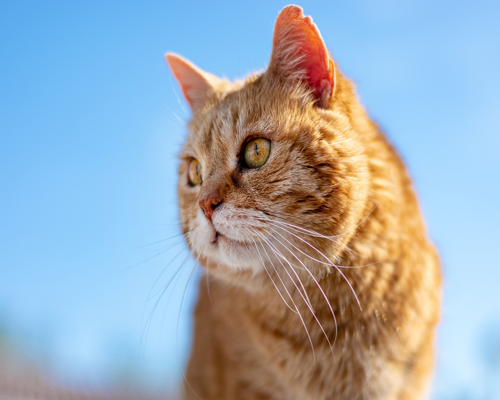

In [ ]:
# 이미지 리사이징

image = Image.open(sample_img_path).resize((500, 400)) # 이미지에 따라 숫자를 조정 가능
image_tensor = F.to_tensor(image) # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255] to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
image

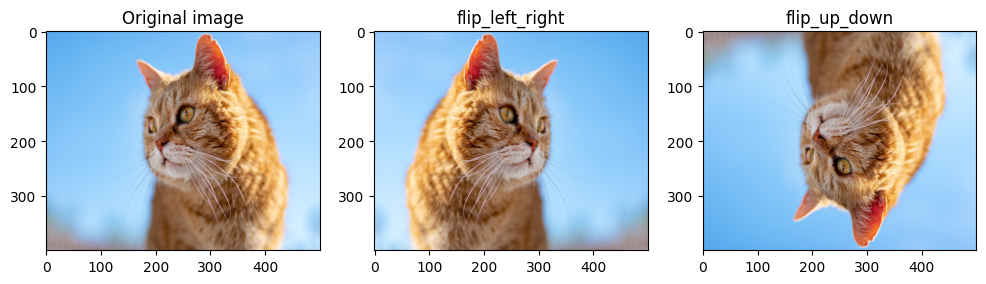

In [ ]:
# Flip 적용

flip_lr_tensor = F.hflip(image_tensor)
flip_ud_tensor = F.vflip(image_tensor)
flip_lr_image = F.to_pil_image(flip_lr_tensor)
flip_ud_image = F.to_pil_image(flip_ud_tensor)

plt.figure(figsize=(12, 12))

plt.subplot(1,3,1)
plt.title('Original image')
plt.imshow(image)

plt.subplot(1,3,2)
plt.title('flip_left_right')
plt.imshow(flip_lr_image)

plt.subplot(1,3,3)
plt.title('flip_up_down')
plt.imshow(flip_ud_image)

plt.show()

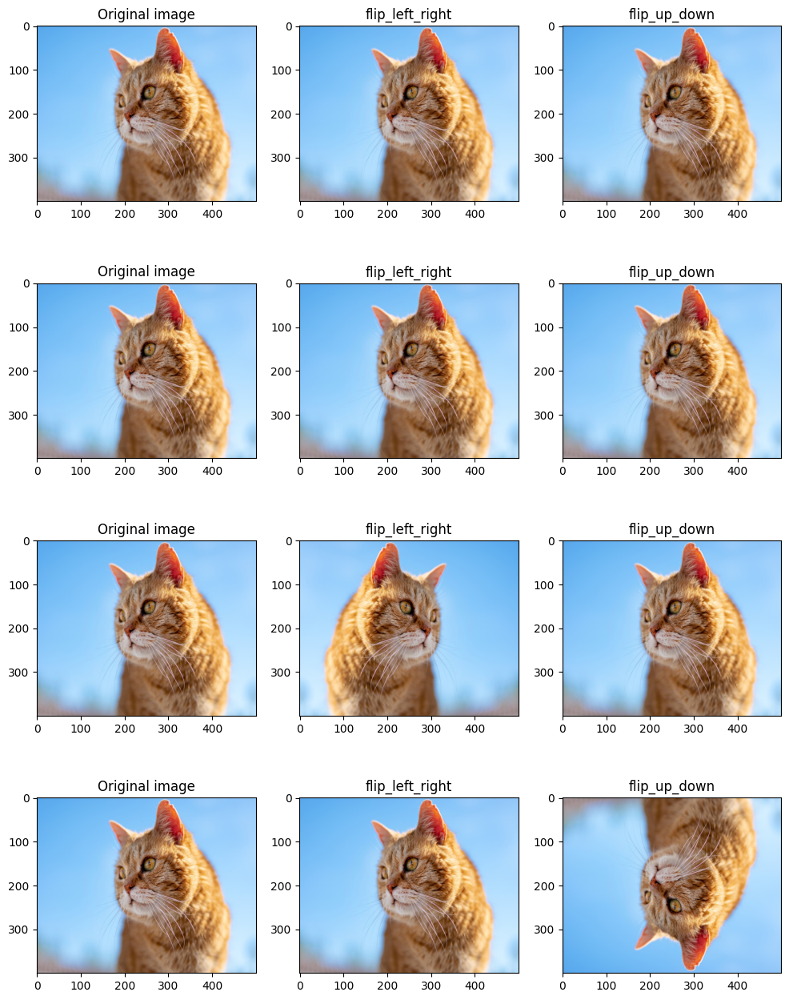

In [ ]:
# Random augmentation의 작동 확인

plt.figure(figsize=(12, 16))
random_flip_lr = transforms.RandomHorizontalFlip(p=0.5)
random_flip_ud = transforms.RandomVerticalFlip(p=0.5)

row = 4
for i in range(row):
    flip_lr_tensor = random_flip_lr(image_tensor)
    flip_ud_tensor = random_flip_ud(image_tensor)
    flip_lr_image = F.to_pil_image(flip_lr_tensor)
    flip_ud_image = F.to_pil_image(flip_ud_tensor)

    plt.subplot(4,3,i*3+1)
    plt.title('Original image')
    plt.imshow(image)

    plt.subplot(4,3,i*3+2)
    plt.title('flip_left_right')
    plt.imshow(flip_lr_image)

    plt.subplot(4,3,i*3+3)
    plt.title('flip_up_down')
    plt.imshow(flip_ud_image)

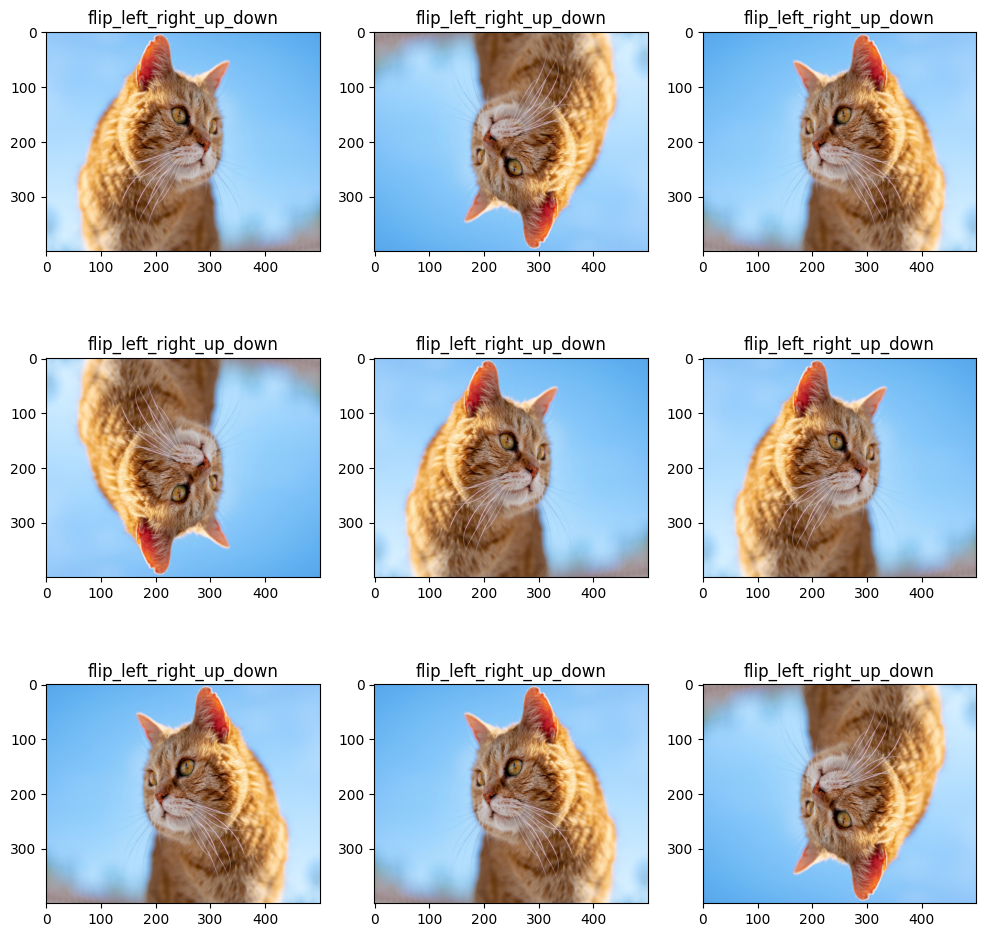

In [ ]:
# Q. random_flip 을 구현

def random_flip(image_tensor):
    flip_lr_tensor = random_flip_lr(image_tensor) # hint : random_flip_left_right()
    flip_ud_lr_tensor = random_flip_ud(flip_lr_tensor) # hint : random_flip_up_down()
    flip_ud_lr_image = F.to_pil_image(flip_ud_lr_tensor) # hint : array_to_img()
    return flip_ud_lr_image

plt.figure(figsize=(12, 12))

num = 9
for i in range(num):
    plt.subplot(3,3,i+1)
    plt.title('flip_left_right_up_down')
    # hint : plt.imshow(함수)
    flipped_image = random_flip(image_tensor)
    plt.imshow(flipped_image)

In [ ]:
# torch.rand을 사용해서 central_fraction 매개변수에 전달할 값을 만들고 이를 사용해 cropped_tensor를 만들어내는 random_central_crop() 함수

def random_central_crop(image_tensor, range=(0, 1)):
    # range 범위에서 무작위로 잘라낼 비율을 선택
    central_fraction = torch.rand(1).item() * (range[1] - range[0]) + range[0]
    crop_size = (int(image_tensor.shape[1] * central_fraction), int(image_tensor.shape[2] * central_fraction))
    cropped_tensor = F.center_crop(image_tensor, crop_size)
    return cropped_tensor

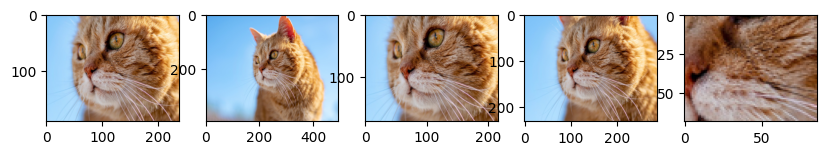

In [ ]:
plt.figure(figsize=(12, 15))

col = 5
for i in range(col):
    cropped_tensor = random_central_crop(image_tensor)
    cropped_img = F.to_pil_image(cropped_tensor)

    plt.subplot(1,col+1,i+1)
    plt.imshow(cropped_img)

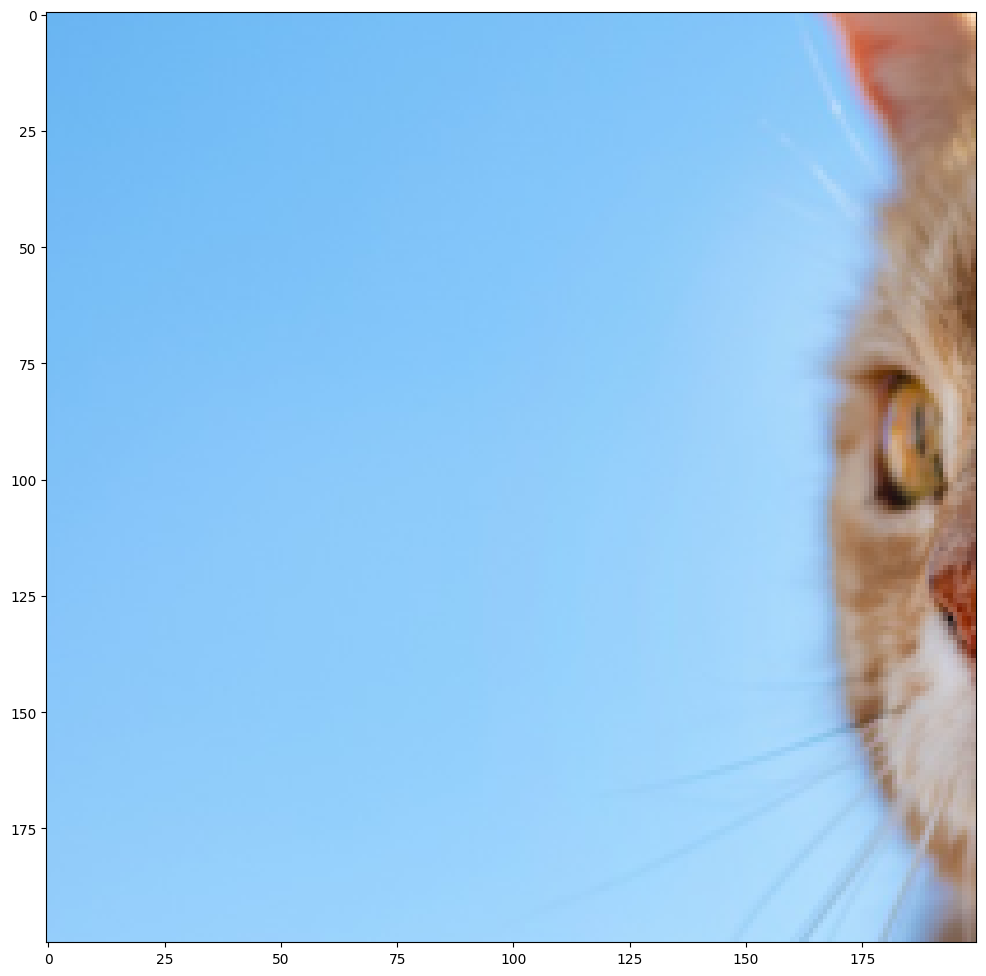

In [ ]:
# 직접 Augmentation 활용(직접 사용할 함수는 torchvision.transforms의 RandomCrop())

# apply random_crop on cat image
plt.figure(figsize=(12, 15))
random_crop = transforms.RandomCrop(size=(200,200))

random_crop_tensor = random_crop(image_tensor)
random_crop_image = F.to_pil_image(random_crop_tensor)

plt.imshow(random_crop_image)
plt.show()

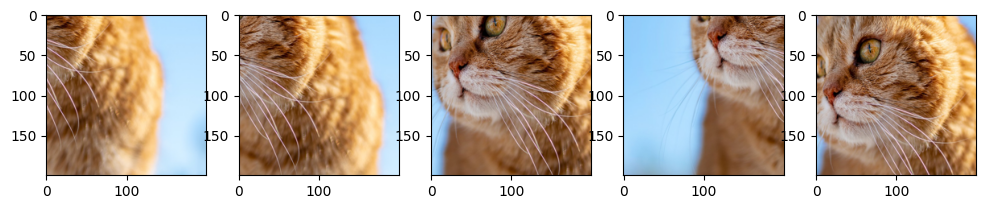

In [ ]:
# display 5 random cropped images

plt.figure(figsize=(12, 15))
random_crop = transforms.RandomCrop(size=(200,200))

for i in range(5):
  random_crop_tensor = random_crop(image_tensor)
  random_crop_image = F.to_pil_image(random_crop_tensor)
  plt.subplot(1, 5, i + 1) # hint : plt.subplot()
  plt.imshow(random_crop_image)

(np.float64(-0.5), np.float64(499.5), np.float64(399.5), np.float64(-0.5))

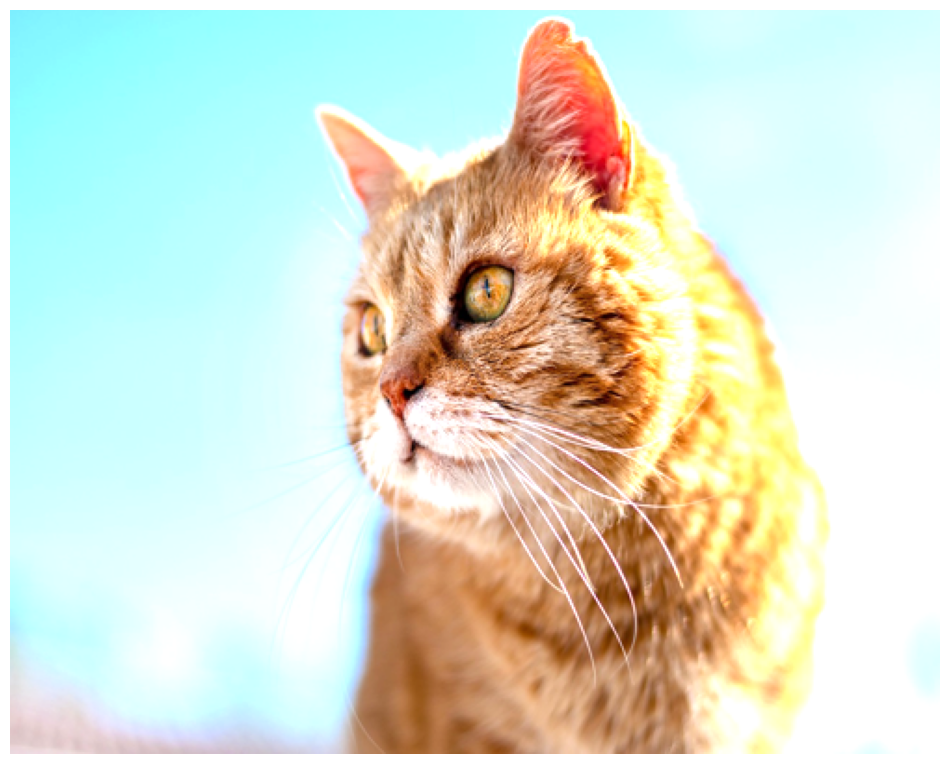

In [ ]:
# apply random_brightness on cat image
plt.figure(figsize=(12, 15))
brightness_transform = transforms.ColorJitter(brightness=0.5)

random_bright_tensor = brightness_transform(image_tensor)
random_bright_image = F.to_pil_image(random_bright_tensor)

plt.imshow(random_bright_image)
plt.axis("off")
# plt.show()

**Albumentations 라이브러리**


*   albumentations은 이미지 증강을 위한 Python 라이브러리로 딥 러닝 및 컴퓨터 비전 작업에서 훈련된 모델의 품질을 높이는 데 사용됩니다.
*   https://github.com/albumentations-team/albumentations



In [ ]:
!pip install -U albumentations

In [ ]:
# Augmentation에서는 배열을 이미지의 기본 형태로 사용하므로 PIL Image 데이터형을 넘파이(numpy) 배열로 변환하여 사용

import numpy as np
image = Image.open(sample_img_path).resize((400, 300)) # 이미지에 따라 숫자를 변경 가능
image_arr = np.array(image)
image_arr.shape

(300, 400, 3)

In [ ]:
def visualize(image):
    plt.figure(figsize=(20, 10))
    plt.imshow(image)

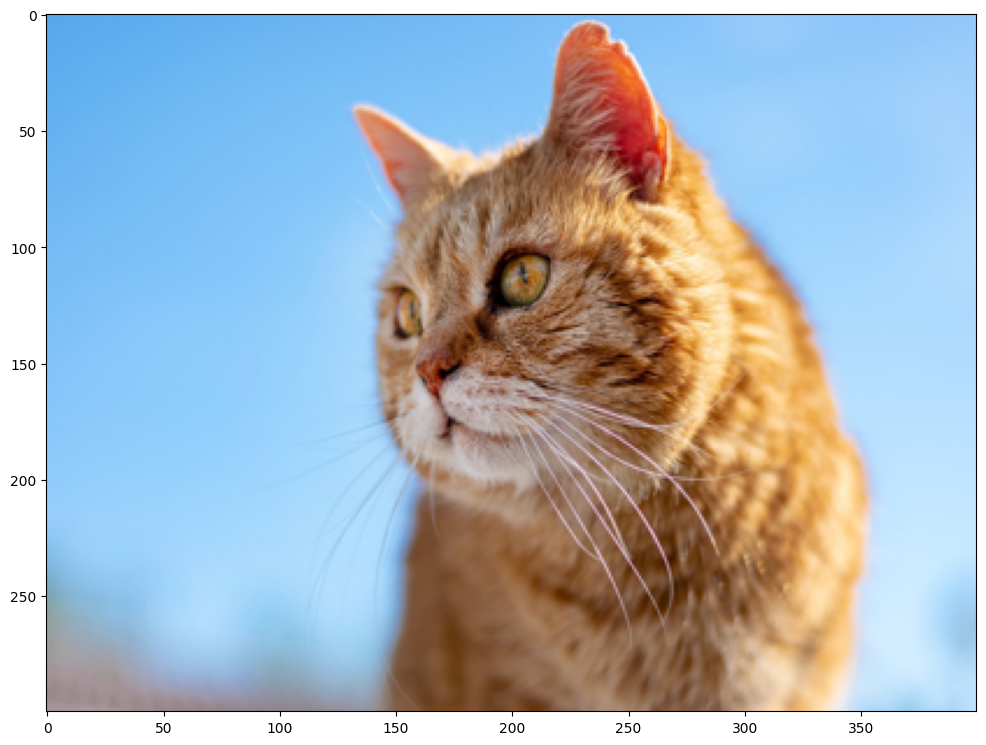

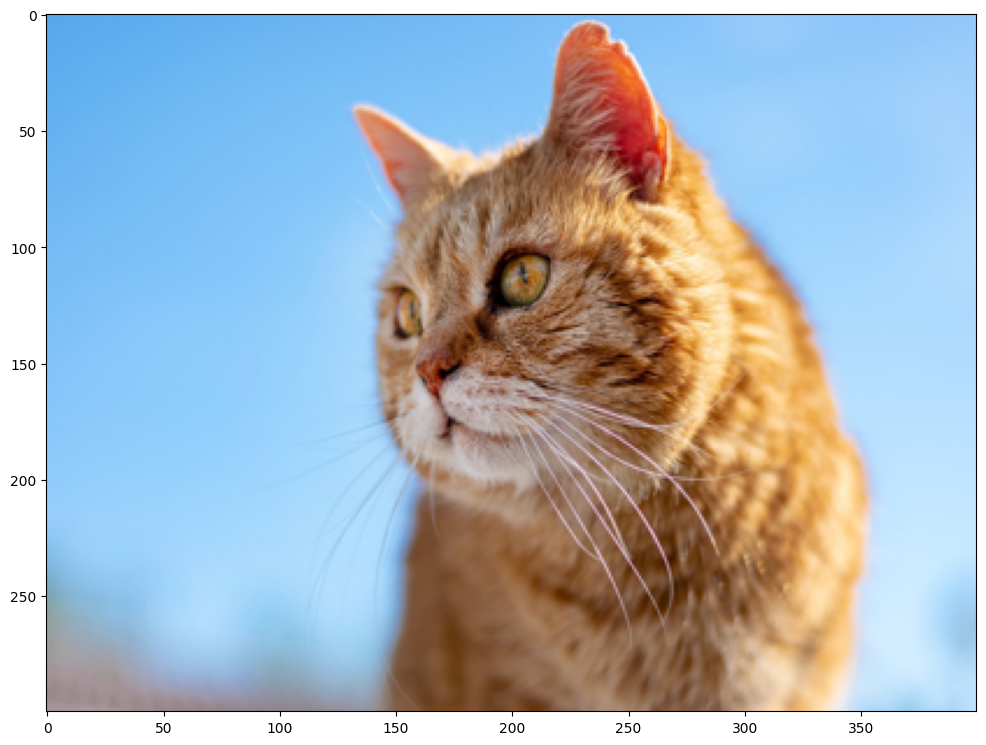

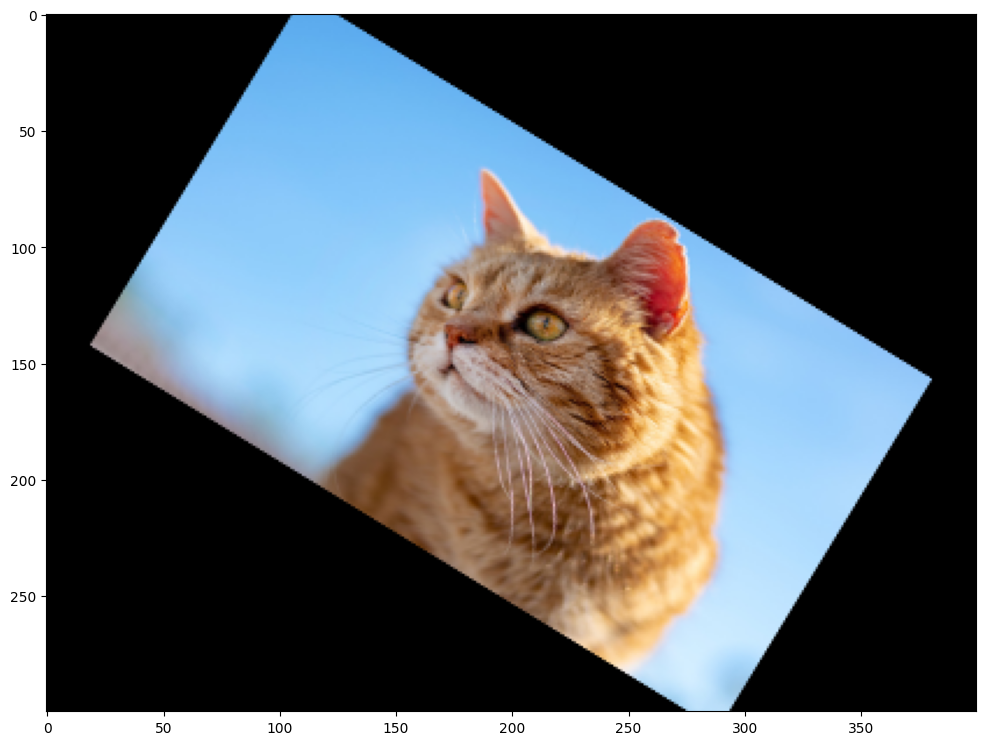

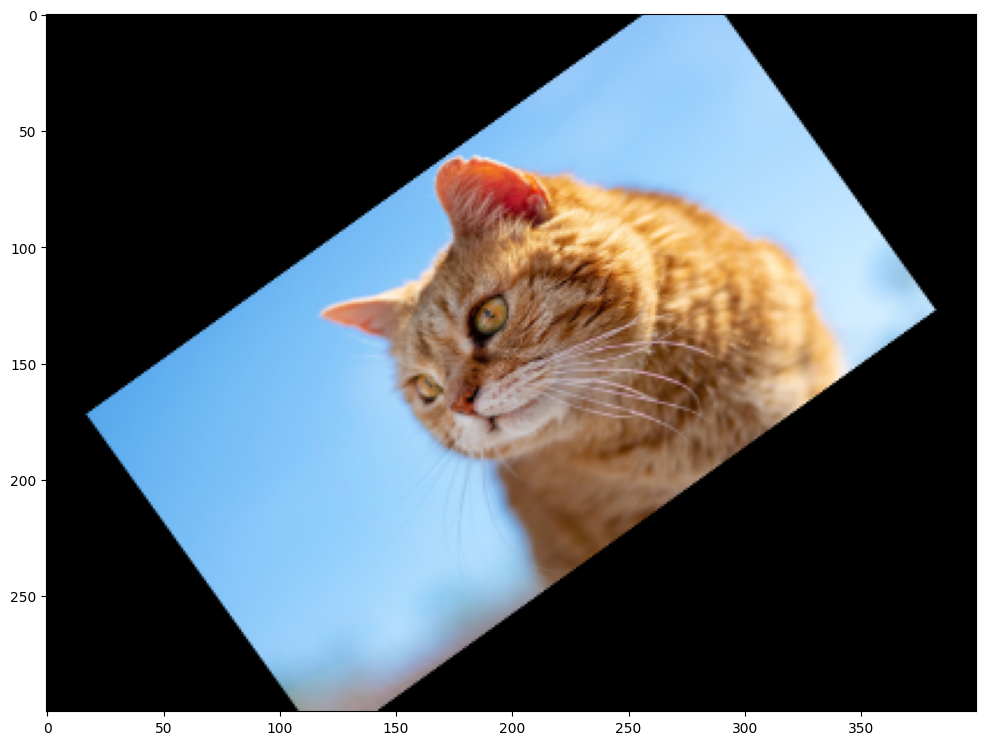

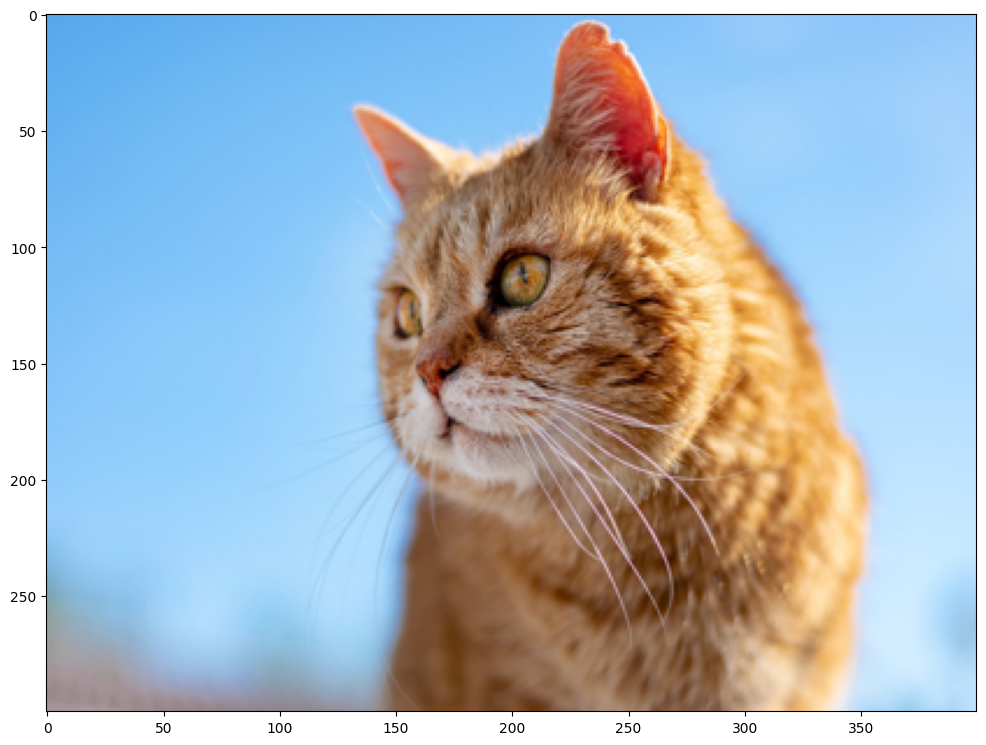

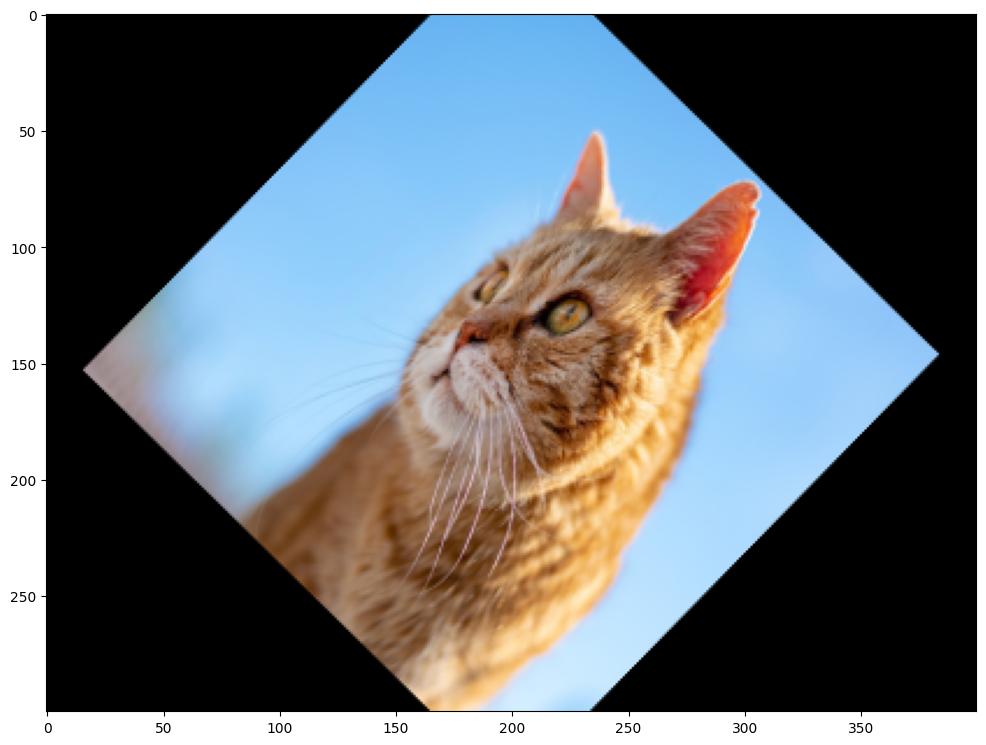

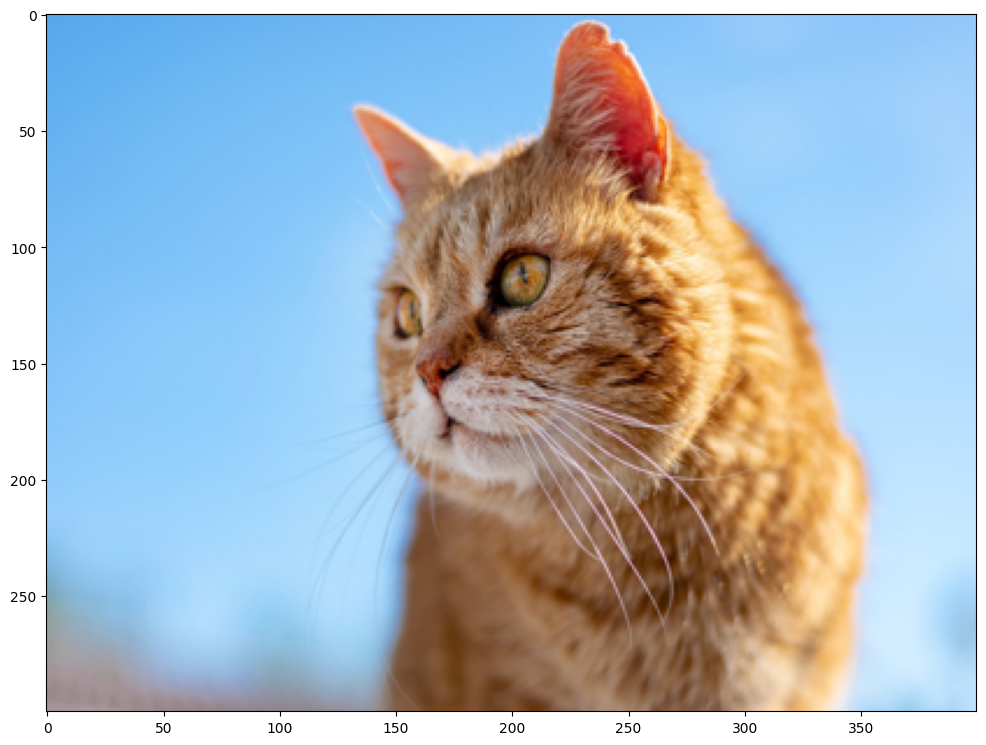

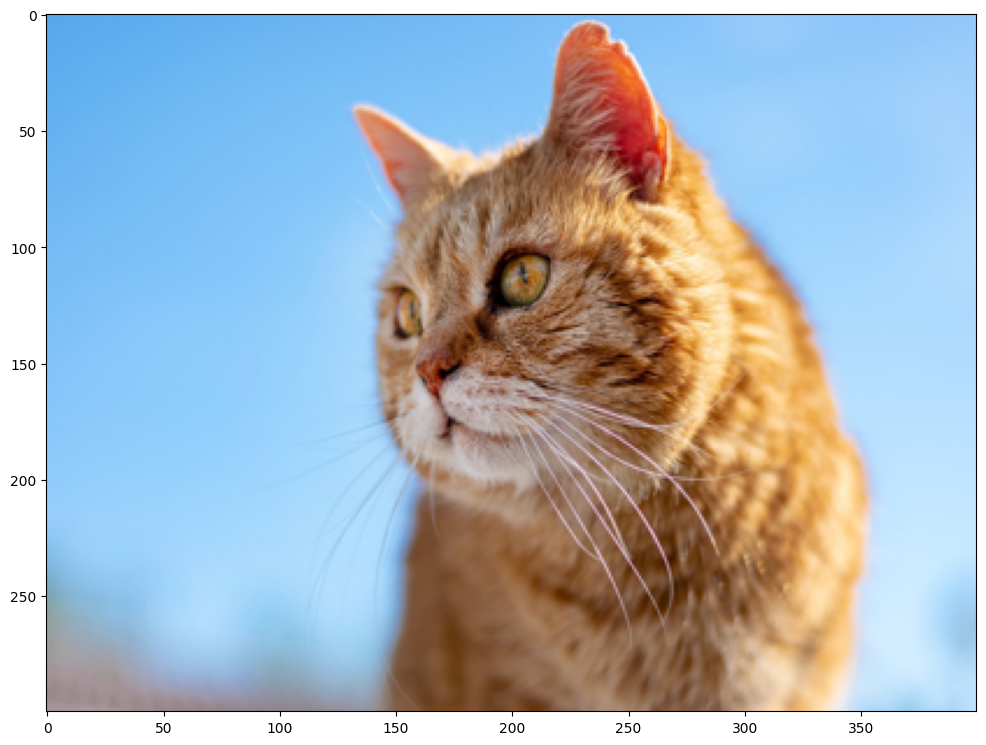

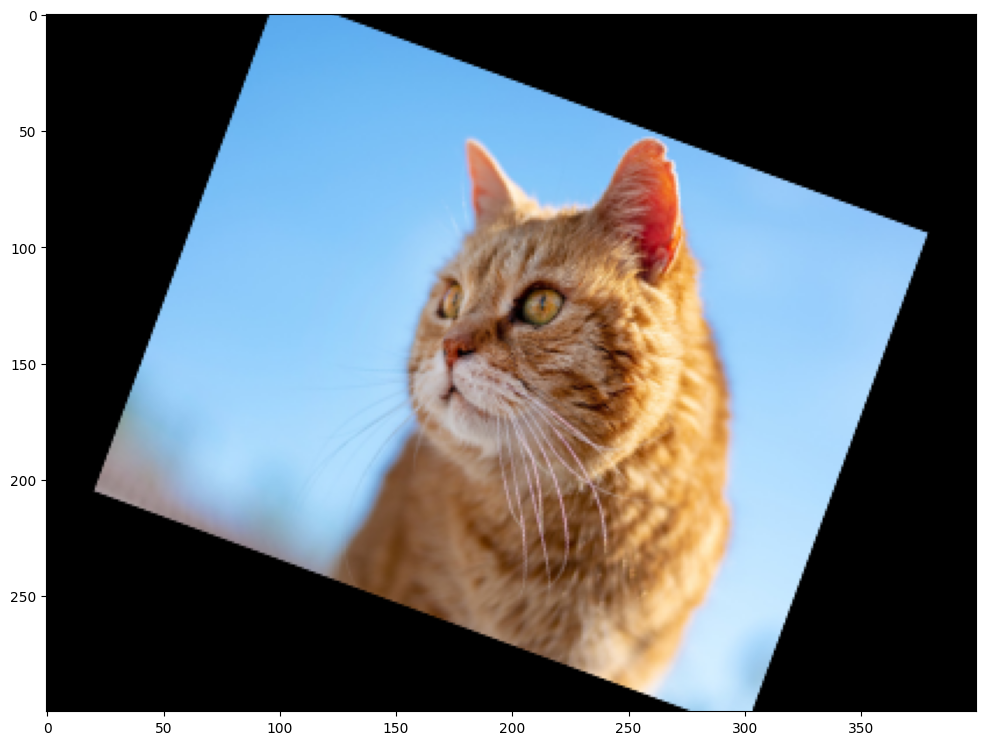

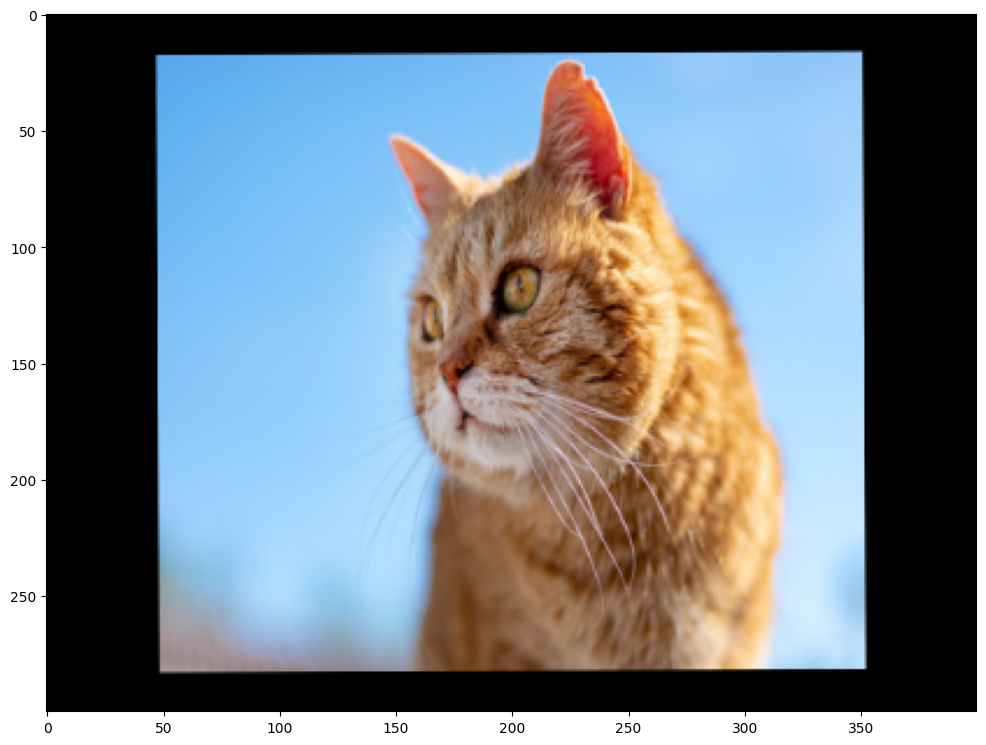

In [ ]:
# Augmentation 기법 사용

# transforms.Affine()
  # transforms.Affine()의 Affine()은 아핀 변환(Affine transform)을 이미지에 적용
  # 2D 변환의 일종인 아핀 변환은 이미지의 스케일(scale)을 조절하거나 평행이동, 또는 회전 등의 변환을 줄 수 있음

import albumentations as A

for i in range(10):
    transform = A.Compose([
        A.Affine(rotate=(-45, 45),scale=(0.5,0.9),p=0.5)
    ])
    transformed = transform(image=image_arr)
    plt.figure(figsize=(12,12))
    plt.imshow((transformed['image']))
    plt.show()

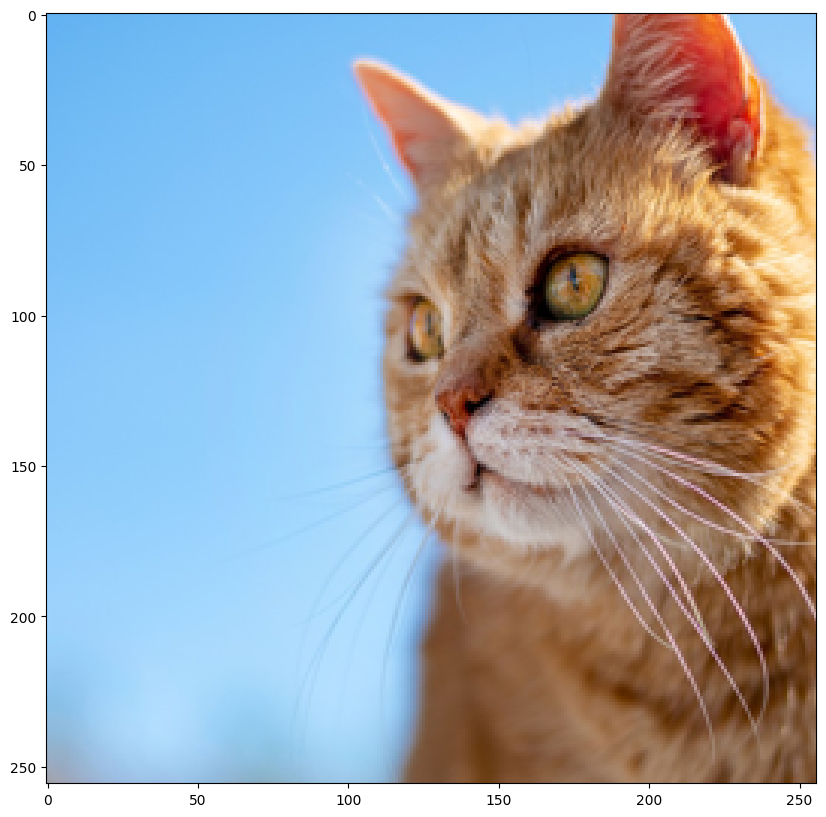

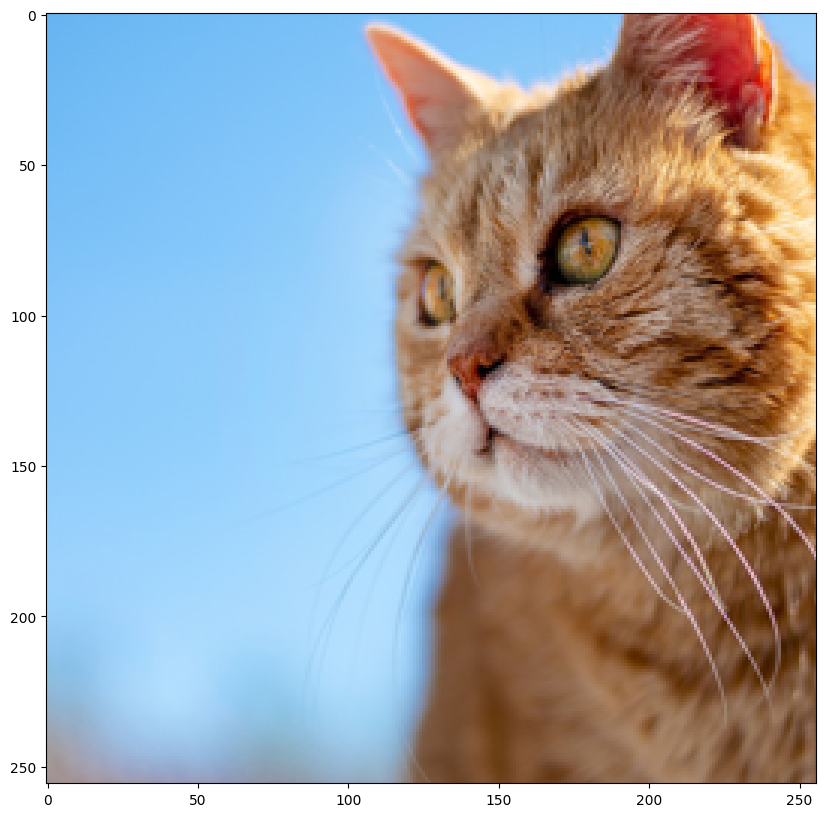

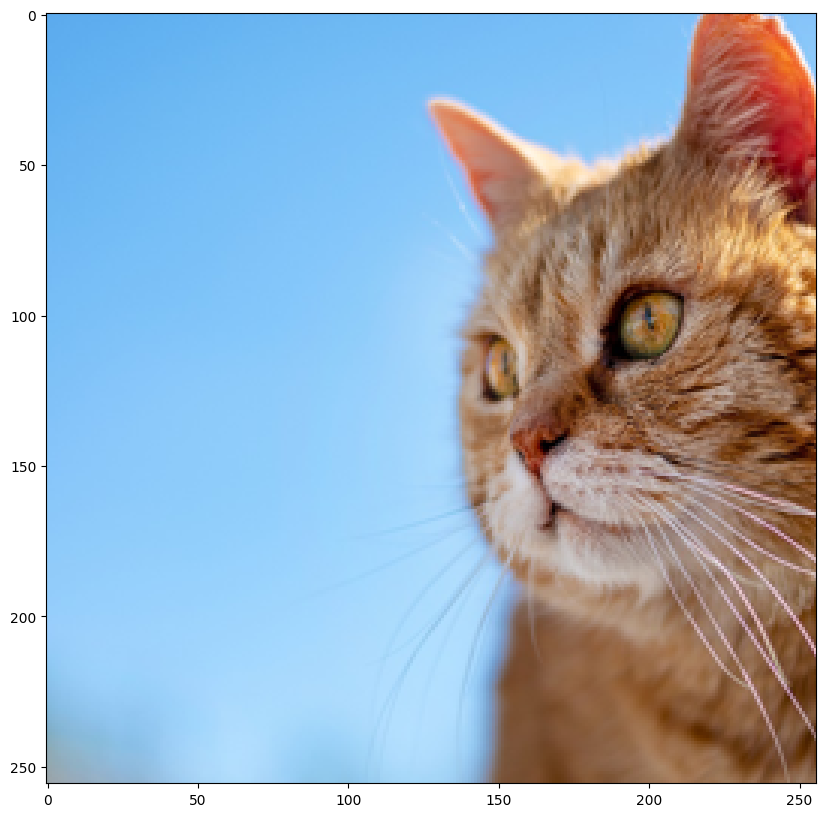

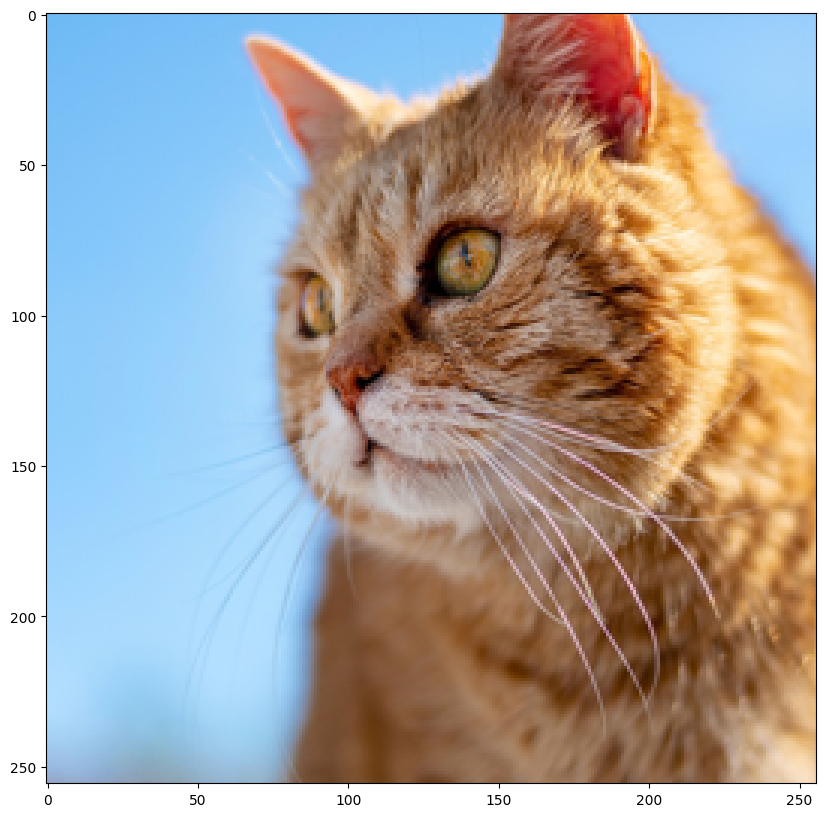

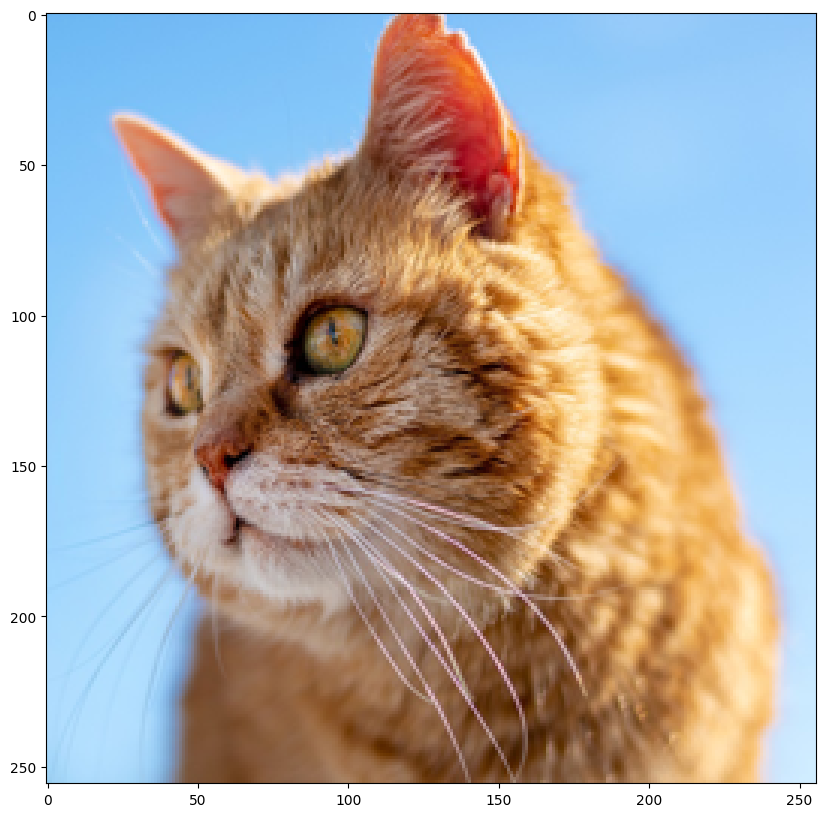

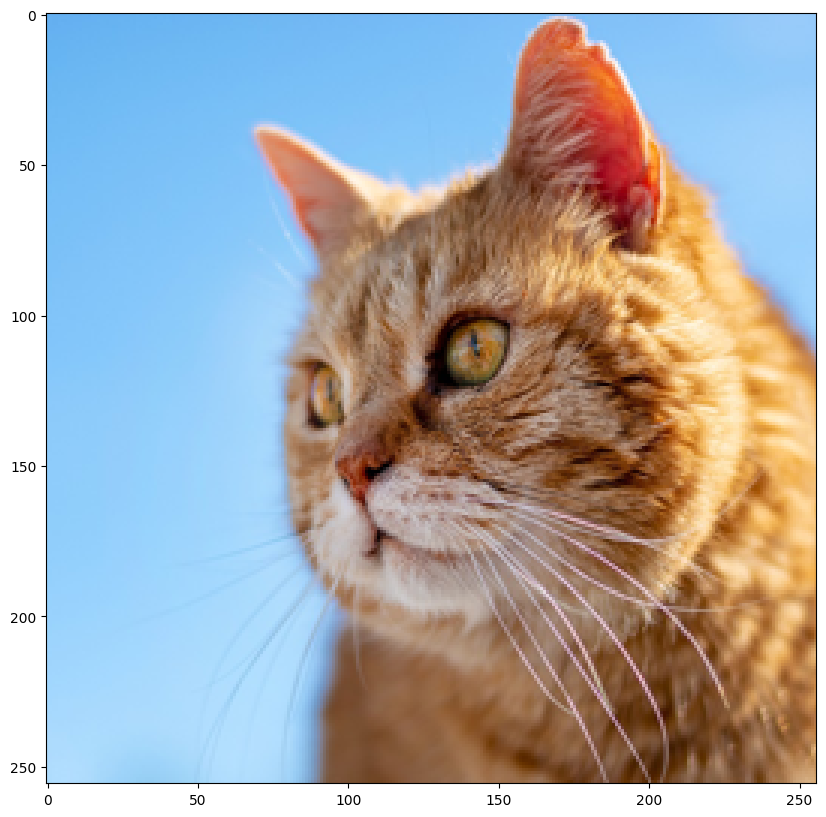

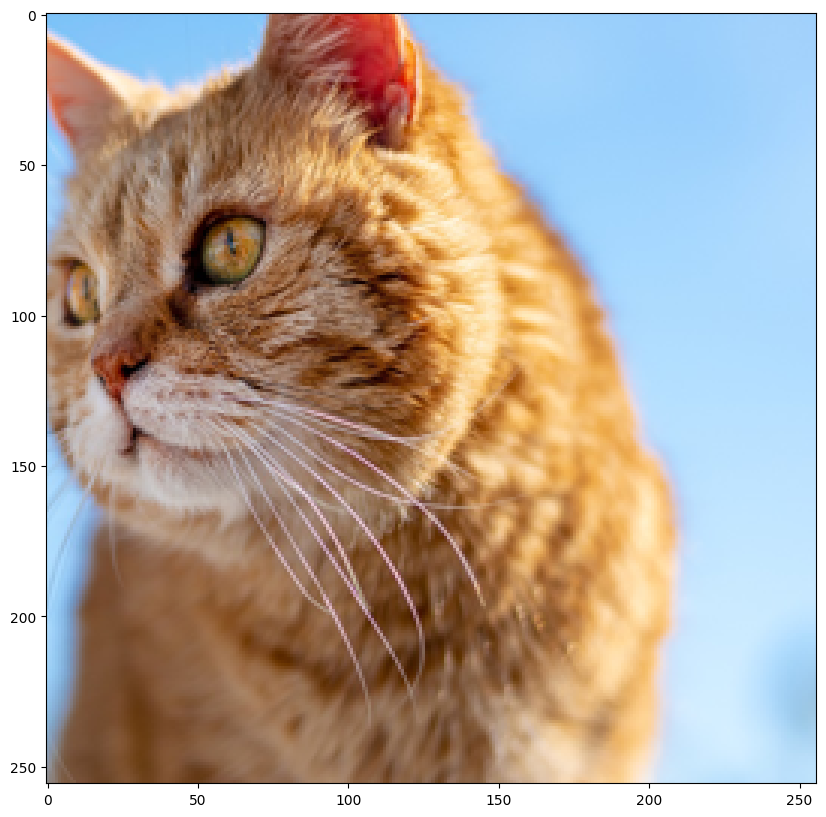

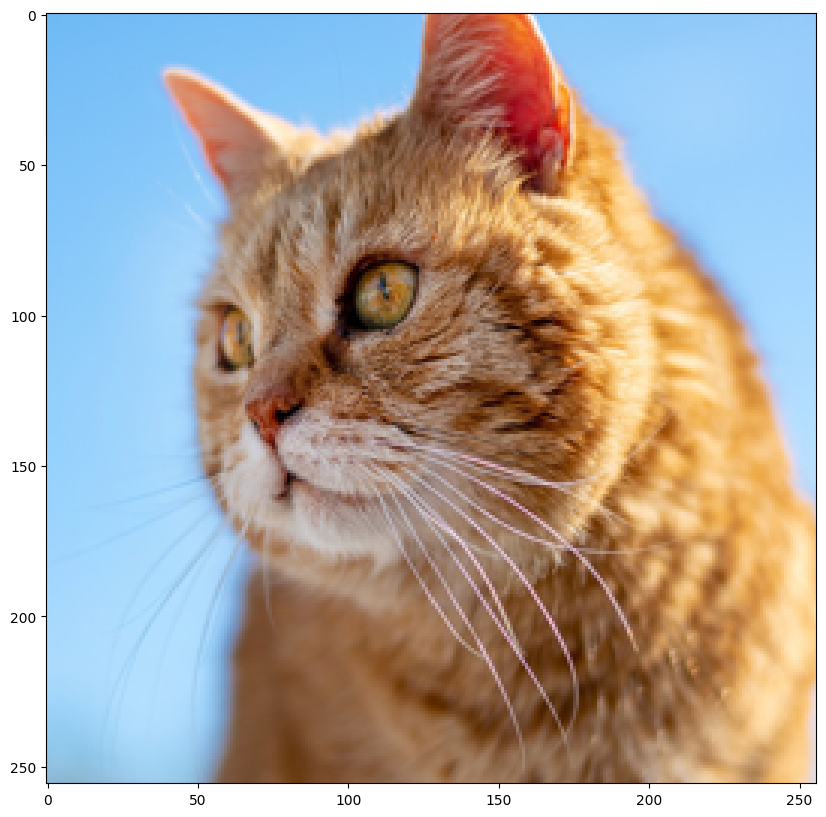

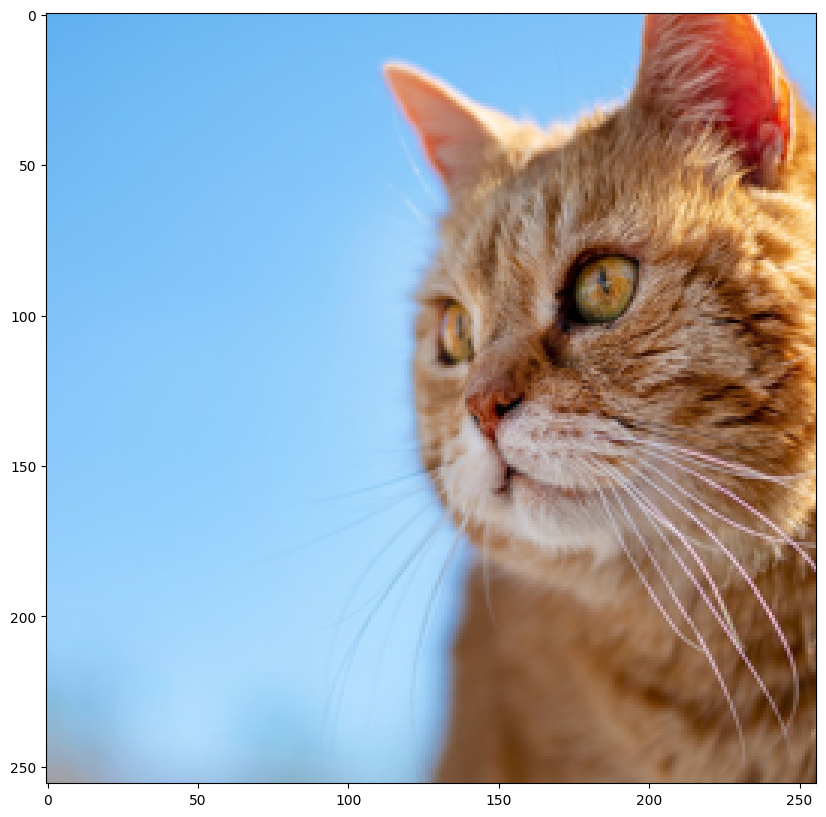

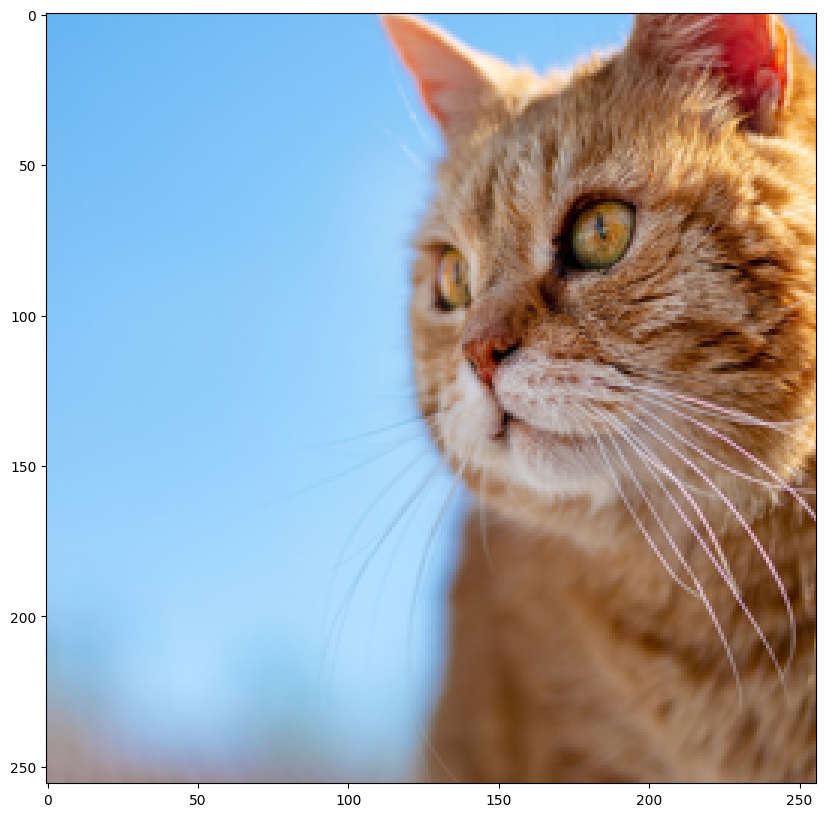

In [ ]:
# transforms.RandomCrop()
  # 256x256 정도의 부분을 랜덤하게 짤 10개 정도 생성

for i in range(10):
    transform = A.Compose(
        [A.RandomCrop(width=256, height=256)]
    )
    transformed = transform(image=image_arr)
    visualize(transformed['image'])

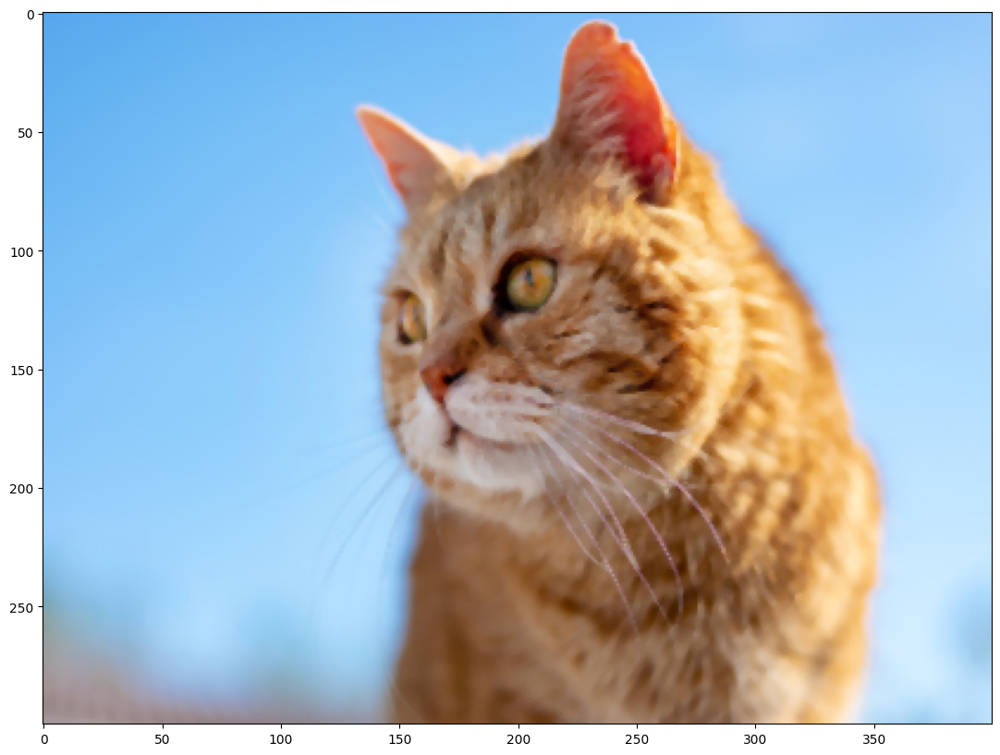

In [ ]:
# MedianBlur()
  # 블러처리

transform = A.Compose(
    [A.MedianBlur(blur_limit=7, p=0.5)]
)
transformed = transform(image=image_arr)
visualize(transformed['image'])

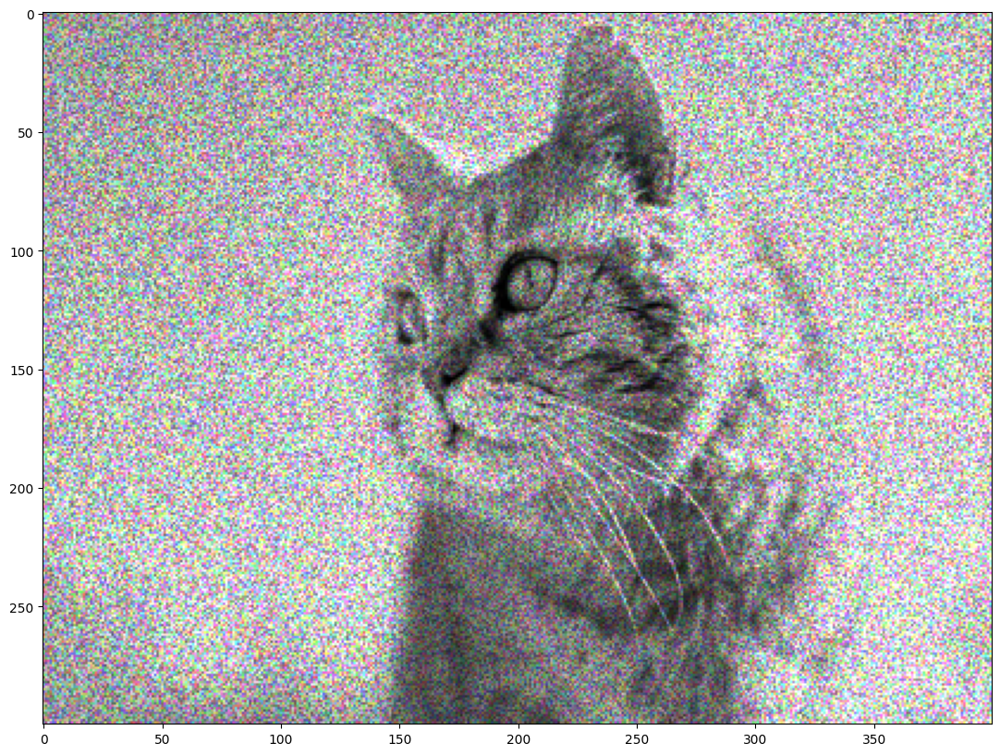

In [ ]:
# ToGray(),MultiplicativeNoise()
  # 여러 가지의 augmentation 기법을 순차적으로 적용

transform = A.Compose(
    [A.ToGray(p=1),
    A.MultiplicativeNoise(multiplier=[0.5, 1.5], elementwise=True, per_channel=True, p=1)]
)
transformed = transform(image=image_arr)
visualize(transformed['image'])

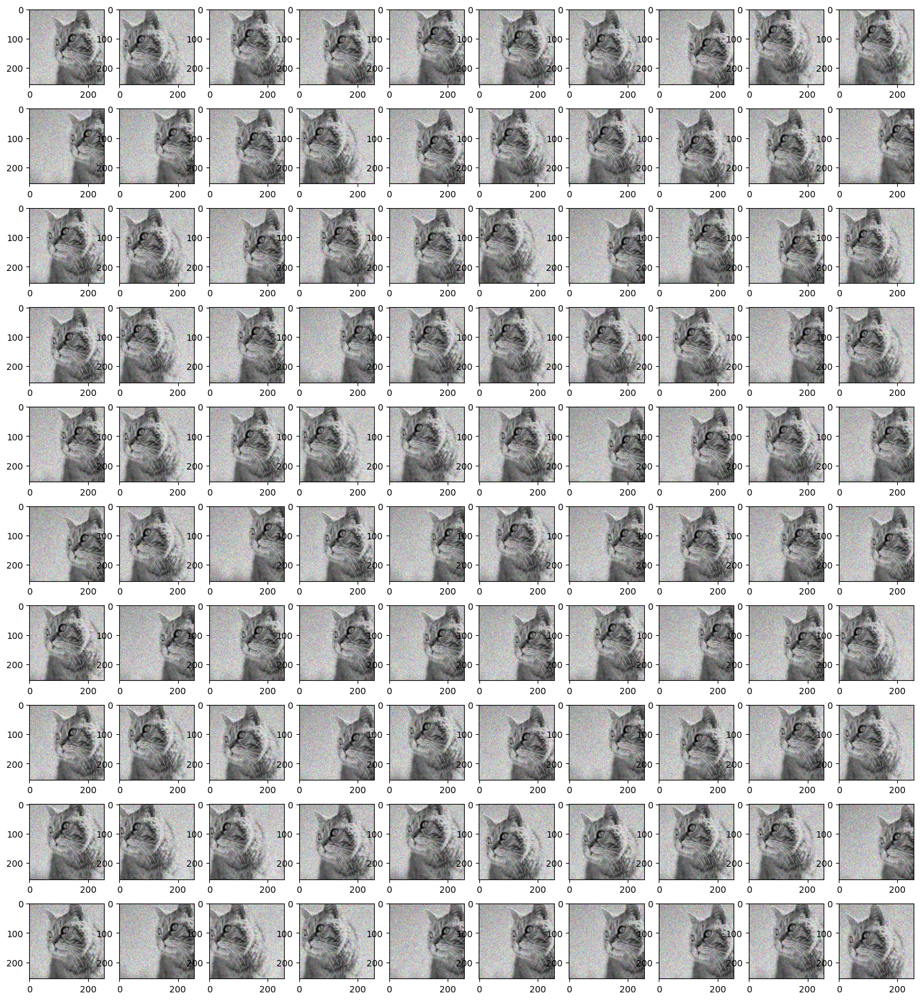

In [ ]:
# 그레이 색상의 노이즈가 있는 RandomCrop()을 사용하여 고양이 이미지 100장을 시각화

def transform_data(img_arr):
    transform = A.Compose(
        [
         A.ToGray(p=1), # hint : A.ToGray()
         A.MultiplicativeNoise(multiplier=[0.5, 1.5], elementwise=True, per_channel=True, p=1), # hint : A.MultiplicativeNoise()
         A.RandomCrop(width=256, height=256, p=1) # hint : A.RandomCrop()
        ]
    )
    t_image = transform(image=img_arr)
    t_image = t_image['image']
    return t_image

plt.figure(figsize=(18,20))
for i in range(100):
    image = transform_data(image_arr)
    plt.subplot(10,10,i+1)
    plt.imshow(image)

# 노드 8. 이미지 어디까지 우려볼까?(프로젝트)

**Image Augmentation 적용**


*   정의 : 기존 이미지를 의미(label)를 유지한 채 다양한 변형을 가하여 학습에 사용되는 이미지 데이터의 다양성과 일반화 능력을 높이는 기법(Chat GPT 참조)


In [ ]:
!mkdir -p content/work/data_augmentation/data

In [ ]:
!pip install --upgrade pip
!pip install --upgrade torch torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 91.9 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 24.1.2
    Uninstalling pip-24.1.2:
      Successfully uninstalled pip-24.1.2
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 915.7/915.7 MB 16.1 MB/s  0:00:26
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.2/12.2 MB 140.3 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 594.3/594.3 MB 37.3 MB/s  0:00:09
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 141.1 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.0/88.0 MB 61.2 MB/s  0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 954.8/954.8 kB 59.5 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 MB 68.8 MB/s  0:00:02
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 75.6 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.6/63.6 MB 60.6 MB/s  0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 267.5/267.5 MB 31.1 MB/s  0:00:08
   ━━━━━━━

In [ ]:
# PyTorch and torchvision

import torch
import torchvision

# Helper libraries

import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# GPU 확인

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

Using device: cuda


In [ ]:
# 데이터셋 불러오기
  # stanford_dogs 데이터셋을 사용(120개 견종의 이미지가 포함, 총 20,580장의 이미지에서 12,000장은 학습셋, 나머지 8,580장은 평가용 데이터셋)

!wget "http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar" -P content/work/data_augmentation/data
!tar -xf content/work/data_augmentation/data/images.tar -C content/work/data_augmentation/data/

--2026-01-22 10:08:17--  http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar
Resolving vision.stanford.edu (vision.stanford.edu)... 171.64.68.10
Connecting to vision.stanford.edu (vision.stanford.edu)|171.64.68.10|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 793579520 (757M) [application/x-tar]
Saving to: ‘content/work/data_augmentation/data/images.tar.1’

images.tar.1        100%[===================>] 756.82M  11.4MB/s    in 63s     

2026-01-22 10:09:21 (12.1 MB/s) - ‘content/work/data_augmentation/data/images.tar.1’ saved [793579520/793579520]



In [ ]:
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as transforms

dataset_dir = "content/work/data_augmentation/data/Images/"

transform = transforms.Compose([
    transforms.Resize((224, 224)),  # 크기 통일
    transforms.ToTensor(),  # Tensor 변환
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # 정규화 추가
])
full_dataset = ImageFolder(root=dataset_dir, transform=transform)

total_size = len(full_dataset)
train_size = int(0.583 * total_size)  # 약 12,000개
test_size = total_size - train_size   # 약 8,580개
ds_train, ds_test = random_split(full_dataset, [train_size, test_size])

train_loader = DataLoader(ds_train, batch_size=32, shuffle=True)
test_loader = DataLoader(ds_test, batch_size=32, shuffle=False)
ds_info = {
    "num_classes": len(full_dataset.classes),
    "class_names": full_dataset.classes
}

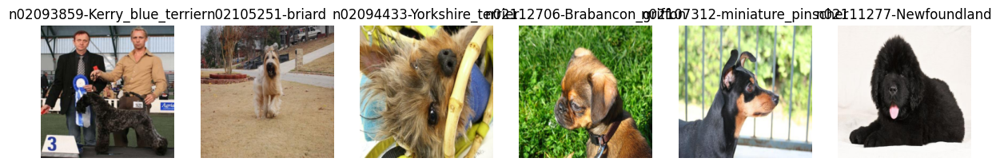

In [ ]:
# DataLoader에서 일부 배치 가져오기

def show_examples(data_loader, class_names, num_images=6):
    data_iter = iter(data_loader)
    images, labels = next(data_iter)

    fig, axes = plt.subplots(1, num_images, figsize=(15, 5))
    for i in range(num_images):
        image = images[i].permute(1, 2, 0).numpy()  # (C, H, W) → (H, W, C)
        image = (image * 0.5) + 0.5
        image = np.clip(image, 0, 1)

        axes[i].imshow(image)
        axes[i].axis('off')
        axes[i].set_title(class_names[labels[i].item()])

    plt.show()

# 훈련 데이터 샘플 시각화

show_examples(train_loader, ds_info["class_names"])

**파이토치 Random Augmentation API 사용하기**

In [ ]:
# 기본적인 전처리 함수

def normalize_and_resize_img():
    return transforms.Compose([
        transforms.Resize((224, 224)),  # 크기 통일
        transforms.ToTensor(),  # Tensor 변환
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # 정규화 추가
    ])

# 이미지 변환의 결과로 리턴 받은 이미지를 그다음 전처리 함수의 입력으로 연거푸 재사용할 수 있는 구조가 되어 편리
# 이 함수는 입력받은 이미지를 0~1 사이의 float32로 normalize하고, (224, 224) 사이즈로 resize
# 이 함수는 훈련용과 테스트용으로 사용될 모든 이미지에 적용될 것입니다.


In [ ]:
# transforms.RandomHorizontalFlip()과 transforms.ColorJitter()를 활용
  # flip"의 경우 좌우 대칭을 해줍니다.
  # 이미지 분류 문제에서 개 이미지는 좌우를 대칭하더라도 문제가 생기지 않으므로 좌우대칭의 적용을 통해 데이터를 늘릴 수 있도록 함
  # 여기서 상하 대칭은 테스트 데이터셋의 이미지를 생각해 볼 때 위아래가 뒤집힌 사진이 없으므로 도움이 되지 않을 것이라 적용하지 않음
  # "brightness"를 조절하여 다양한 환경에서 얻어진 이미지에 대응할 수 있도록 함

def augment():
    return transforms.Compose([
        transforms.RandomHorizontalFlip(p=0.5),
        transforms.ColorJitter(brightness=0.2)
    ])

In [ ]:
# 데이터셋을 가공하는 메인함수

  # 오늘의 Augmentation을 통해 원본 데이터셋에 다양한 형태의 가공한 형태의 새로운 데이터셋을 얻게 되는 모든 과정을 구현한 메인 함수를 apply_normalize_on_dataset()로 정의오늘의 Augmentation을 통해 원본 데이터셋에 다양한 형태의 가공한 형태의 새로운 데이터셋을 얻게 되는 모든 과정을 구현한 메인 함수를 apply_normalize_on_dataset()로 정의
  # apply_normalize_on_dataset()를 통해서 일반적인 전처리 과정, 즉 normalize, resize, augmentation과 shuffle을 적용
  # 이때 주의해야 할 점은 shuffle이나 augmentation은 테스트 데이터셋에는 적용하지 않아야 한다는 점

def apply_normalize_on_dataset(dataset, is_test=False, batch_size=16, with_aug=False):
    transform = normalize_and_resize_img()

    if not is_test and with_aug:
        dataset.dataset.transform = transforms.Compose([
            *augment().transforms,
            *transform.transforms
        ])
    else:
        dataset.dataset.transform = transform

    return DataLoader(dataset, batch_size=batch_size, shuffle=not is_test, num_workers=2, pin_memory=True)

**테스트 타임 증강**


*   여러 결과를 조합하기 위한 앙상블(ensemble) 방법 중 하나로 테스트 데이터셋에 augmentation을 적용하는 test-time augmentation이라는 방법이 있음(캐글 등의 머신러닝에 많이 사용)
*   https://modulabs.co.kr/blog/test-time-augmentation-computer-vision?_gl=1*f9z3x2*_gcl_au*MjI5NDU1NDc4LjE3NjU2MjYwNjM.*_ga*ODQ2MzMxMTE1LjE3NjU2MjYwNjM.*_ga_NMZ7QB8XG7*czE3NjkwNTc5NTkkbzU0JGcxJHQxNzY5MDYxMjI0JGoxNyRsMCRoMA..



**Random Augmentation 직접 구현**

In [ ]:
# torchvision.transforms의 다양한 함수들을 이용해서 직접 다양한 augmentation 기법을 랜덤하게 적용하는 augment2() 함수를 작성

import random

def augment2():
    return transforms.Compose([
        transforms.RandomHorizontalFlip(p=0.5),  # 좌우 반전
        transforms.RandomVerticalFlip(p=0.5),    # 상하 반전
        transforms.RandomRotation(degrees=(0, 90, 180, 270)),  # 90도 단위 회전
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),  # 밝기, 대비, 색상 조정
        transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),  # 랜덤 크롭 후 리사이즈
        transforms.Lambda(lambda img: torch.clamp(img, 0, 1))  # 0~1 값으로 클리핑
    ])

**비교 실험하기**


*   Augmentation을 적용한 데이터를 학습시킨 모델과 적용하지 않은 데이터를 학습시킨 모델의 성능 비교
*   새로운 함수로 augmentation한 데이터와 아닌 데이터를 학습시켜서 어떤 효과가 있는지 실험을 통해 도출



In [ ]:
# ResNet50 중 imagenet으로 훈련된 모델을 불러옴
# resnet50.fc은 마지막 fully connected layer를 포함할지 여부
# 해당 레이어를 포함하지 않고 생성하면 특성 추출기(feature extractor) 부분만 불러와 우리의 필요에 맞게 수정된 fully connected layer를 붙여서 활용 가능
# 이렇게 하는 이유는 이미지넷(ImageNet)과 우리의 테스트셋이 서로 다른 클래스를 가지므로, 마지막에 추가해야 하는 fully connected layer의 구조(뉴런의 개수) 또한 다르기 때문임

import torch.nn as nn
import torchvision.models as models

num_classes = len(ds_info["class_names"])
resnet50 = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
resnet50.fc = nn.Linear(resnet50.fc.in_features, num_classes)

model = nn.Sequential(
    resnet50,
    nn.AdaptiveAvgPool2d((1, 1)),
    nn.Flatten(),
    nn.Linear(resnet50.fc.in_features, num_classes),
    nn.Softmax(dim=1)
)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


100%|██████████| 97.8M/97.8M [00:00<00:00, 202MB/s]


In [ ]:
# Augmentation을 적용한 데이터셋으로 학습시킬 ResNet을 하나 더 추가

aug_resnet50 = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
aug_resnet50.fc = nn.Linear(aug_resnet50.fc.in_features, num_classes)

aug_resnet50 = nn.Sequential(
    aug_resnet50,
    nn.Softmax(dim=1)
)

In [ ]:
# 토치비전 데이터셋에서 불러온 데이터에 하나는 apply_normalize_on_dataset()에서 with_aug를 False로 주어 augmentation이 적용되지 않도록 하고, 다른 하나는 True로 주어 augmentation이 적용

ds_train_no_aug = apply_normalize_on_dataset(ds_train, with_aug=False)
ds_train_aug = apply_normalize_on_dataset(ds_train, with_aug=True)
ds_test = apply_normalize_on_dataset(ds_test, is_test=True)

In [ ]:
# 두 개 모델에 각각 augmentation이 적용된 데이터셋과 적용되지 않은 데이터셋을 학습시키고 검증을 진행

%%time
import torch.optim as optim

#EPOCH = 20  # Augentation 적용 효과를 확인하기 위해 필요한 epoch 수
EPOCH = 3
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(resnet50.parameters(), lr=0.001)

def train(model, train_loader, test_loader, epochs):
    model.to(device)
    history = {'val_accuracy': []}

    for epoch in range(epochs):
        model.train()
        correct = 0
        total = 0

        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

        train_acc = 100. * correct / total
        print(f"Epoch [{epoch+1}/{epochs}], Accuracy: {train_acc:.2f}%")

        model.eval()
        correct = 0
        total = 0
        with torch.no_grad():
            for images, labels in test_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                _, predicted = outputs.max(1)
                total += labels.size(0)
                correct += predicted.eq(labels).sum().item()

        val_acc = 100. * correct / total
        history['val_accuracy'].append(val_acc)
        print(f"Validation Accuracy: {val_acc:.2f}%")

    return history

history_resnet50_no_aug = train(resnet50, ds_train_no_aug, ds_test, EPOCH)

Epoch [1/3], Accuracy: 14.00%
Validation Accuracy: 36.02%
Epoch [2/3], Accuracy: 44.81%
Validation Accuracy: 60.02%
Epoch [3/3], Accuracy: 60.73%
Validation Accuracy: 70.02%
CPU times: user 5min 30s, sys: 11.5 s, total: 5min 41s
Wall time: 7min 53s


In [ ]:
def train(model, train_loader, test_loader, criterion, optimizer, epochs):
    model.to(device)
    history = {'val_accuracy': []}

    for epoch in range(epochs):
        model.train()
        correct = 0
        total = 0

        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

        print(f"Epoch [{epoch+1}/{epochs}] Train Acc: {100.*correct/total:.2f}%")

        model.eval()
        correct = 0
        total = 0
        with torch.no_grad():
            for images, labels in test_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                _, predicted = outputs.max(1)
                total += labels.size(0)
                correct += predicted.eq(labels).sum().item()

        val_acc = 100. * correct / total
        history['val_accuracy'].append(val_acc)
        print(f"Validation Acc: {val_acc:.2f}%")

    return history

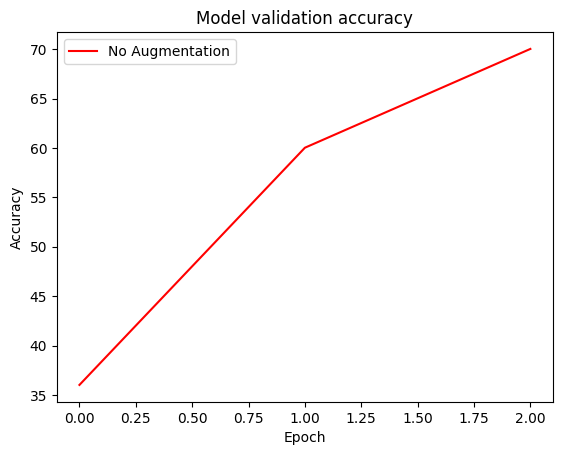

In [ ]:
# 훈련과정 시각화

plt.plot(history_resnet50_no_aug['val_accuracy'], 'r', label='No Augmentation')

if 'history_resnet50_aug' in globals():
    plt.plot(history_resnet50_aug['val_accuracy'], 'b', label='With Augmentation')

plt.title('Model validation accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()


**심화기법**

**Cutmix Augmentation**

1.   CutMix: Regularization Strategy to Train Strong Classifiers with Localizable Features(https://arxiv.org/pdf/1905.04899)

    *   CutMix는 네이버 클로바(CLOVA)에서 발표한 CutMix: Regularization Strategy to Train Strong Classifiers with Localizable Features 에서 제안된 방법

2.   Chris Deotte's CutMix and MixUp on GPU/TPU(https://www.kaggle.com/code/cdeotte/cutmix-and-mixup-on-gpu-tpu)

    *   Chris Deotte's CutMix and MixUp on GPU/TPU에서는 캐글 그랜드마스터인 Chris Deotte가 구현한 CutMix와 MixUp

**이미지 섞기**



*   바운딩 박스(bounding box) : 이미지에서 잘라서 섞어주는 영역



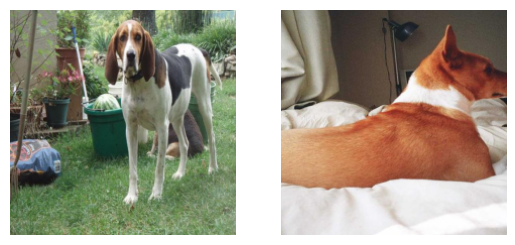

In [ ]:
# 바운딩 박스의 위치를 랜덤하게 뽑고 이를 잘라내서 두 개의 이미지를 섞어주는 함수
# 이미지를 텐서로 만들어 텐서플로우 연산을 사용
# 이때 이미지는 tfds에서 한 장을 뽑아서 사용

import matplotlib.pyplot as plt

# 데이터셋에서 이미지 2개를 가져옵니다.
data_iter = iter(ds_train_no_aug)
images, labels = next(data_iter)

# 첫 번째 배치에서 두 개의 이미지 선택
image_a = images[0].permute(1, 2, 0).numpy()
image_b = images[1].permute(1, 2, 0).numpy()
label_a = labels[0].item()
label_b = labels[1].item()

# 정규화된 텐서를 다시 [0, 1] 범위로 조정
image_a = (image_a * 0.5) + 0.5
image_b = (image_b * 0.5) + 0.5

# 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(image_a)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(image_b)
plt.axis('off')

plt.show()

In [ ]:
# 이미지 a, b가 모두 (224, 224)로 resize되어 두 이미지의 width, height가 같은 경우로 가정 가능
# CutMix 공식 repo 에서는 width, height가 다르더라도 가변적으로 적용할 수 있도록 구현되어 있기 때문에, 임의의 이미지 사이즈에 대해서도 유연하게 대응 가능하도록 구현

def get_clip_box(image_a, image_b):
    # image.shape = (channel, height, width)
    image_size_x = image_a.shape[2]  # Width
    image_size_y = image_a.shape[1]  # Height

    # Get center of box
    x = torch.randint(0, image_size_x, (1,)).item()
    y = torch.randint(0, image_size_y, (1,)).item()

    width = max(1, int(image_size_x * torch.sqrt(1 - torch.rand(1)).item()))
    height = max(1, int(image_size_y * torch.sqrt(1 - torch.rand(1)).item()))

    # Clip box in image and get minmax bbox
    x_min = max(0, x - width // 2)
    y_min = max(0, y - height // 2)
    x_max = min(image_size_x, x + width // 2 + 1)
    y_max = min(image_size_y, y + height // 2 + 1)

    return x_min, y_min, x_max, y_max

x_min, y_min, x_max, y_max = get_clip_box(image_a, image_b)

print('x :', x_min, x_max)
print('y :', y_min, y_max)

x : 0 2
y : 0 116


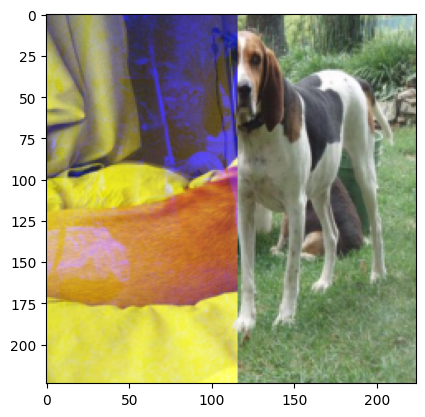

In [ ]:
# 바탕이미지 image_a에서 바운딩 박스 바깥쪽 영역을, 다른 이미지 image_b에서 바운딩 박스 안쪽 영역을 가져와서 합치는 함수를 구현

import torch

def mix_2_images(image_a, image_b, x_min, y_min, x_max, y_max):
    # image.shape = (C, H, W)
    image_size_x = image_a.shape[2]  # Width
    image_size_y = image_a.shape[1]  # Height

    if isinstance(image_a, np.ndarray):
        image_a = torch.from_numpy(image_a).to(device)
    if isinstance(image_b, np.ndarray):
        image_b = torch.from_numpy(image_b).to(device)

    top = image_a[:, :y_min, :]
    middle_left = image_a[:, y_min:y_max, :x_min]
    middle_center = image_b[:, y_min:y_max, x_min:x_max]
    middle_right = image_a[:, y_min:y_max, x_max:]
    bottom = image_a[:, y_max:, :]

    top = top.to(device)
    middle_left = middle_left.to(device)
    middle_center = middle_center.to(device)
    middle_right = middle_right.to(device)
    bottom = bottom.to(device)

    # 중간 부분(왼쪽, 중앙, 오른쪽) 결합
    middle = torch.cat([middle_left, middle_center, middle_right], dim=2)

    # 전체 이미지 결합 (위 + 중간 + 아래)
    mixed_img = torch.cat([top, middle, bottom], dim=1)

    return mixed_img

mixed_img = mix_2_images(image_a, image_b, x_min, y_min, x_max, y_max)

plt.imshow(mixed_img.cpu().numpy())
plt.show()

In [ ]:
# 라벨 섞기
  # 이미지를 섞었다면 라벨도 이에 맞게 섞어주어야 함
  # CutMix에서는 면적에 비례해서 라벨을 섞어줌
  # 섞인 이미지의 전체 이미지 대비 비율을 계산해서 두 가지 라벨의 비율로 더해줌
  # 예를 들어 A 클래스를 가진 원래 이미지 image_a와 B 클래스를 가진 이미지 image_b를 섞을 때 image_a를 0.4만큼 섞었을 경우, 0.4만큼의 클래스 A, 0.6만큼의 클래스 B를 가지도록 해줌
  # 이때 라벨 벡터는 보통 클래스를 표시하듯 클래스 1개만 1의 값을 가지는 원-핫 인코딩이 아니라 A와 B 클래스에 해당하는 인덱스에 각각 0.4, 0.6을 배분하는 방식을 사용

import torch.nn.functional as F

# mix two labels
def mix_2_labels(label_a, label_b, x_min, y_min, x_max, y_max, num_classes=120):
    image_size_x = image_a.shape[2]  # Width
    image_size_y = image_a.shape[1]  # Height

    # 바운딩 박스 비율 계산
    mixed_area = (x_max - x_min) * (y_max - y_min)
    total_area = image_size_x * image_size_y
    ratio = mixed_area / total_area

     # 원-핫 벡터 변환
    if isinstance(label_a, int):
        label_a = F.one_hot(torch.tensor(label_a), num_classes=num_classes).float()
    if isinstance(label_b, int):
        label_b = F.one_hot(torch.tensor(label_b), num_classes=num_classes).float()

    # 비율에 따라 라벨 혼합
    mixed_label = (1 - ratio) * label_a + ratio * label_b
    return mixed_label

# 예제 실행
mixed_label = mix_2_labels(label_a, label_b, x_min, y_min, x_max, y_max)
print(mixed_label)

tensor([0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.6548, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.3452, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 

In [ ]:
# mix_2_images()와 mix_2_label()을 활용하여 배치 단위의 cutmix() 함수를 구현

def cutmix(images, labels, prob=1.0, batch_size=16, img_size=224, num_classes=120):
    mixed_imgs = []
    mixed_labels = []

    for i in range(batch_size):
        image_a = images[i]
        label_a = labels[i]

        j = torch.randint(0, batch_size, (1,)).item()  # 다른 샘플 선택
        image_b = images[j]
        label_b = labels[j]

        # 바운딩 박스 생성
        x_min, y_min, x_max, y_max = get_clip_box(image_a, image_b)

        # 이미지 섞기
        mixed_imgs.append(mix_2_images(image_a, image_b, x_min, y_min, x_max, y_max))
        mixed_labels.append(mix_2_labels(label_a, label_b, x_min, y_min, x_max, y_max, num_classes))

    # 텐서 변환
    mixed_imgs = torch.stack(mixed_imgs).reshape(batch_size, 3, img_size, img_size)
    mixed_labels = torch.stack(mixed_labels).reshape(batch_size, num_classes)

    return mixed_imgs, mixed_labels

**Mixup Augmentation**

*   CutMix보다 간단하게 이미지와 라벨을 섞어주는 방식
*   두 개 이미지의 픽셀별 값을 비율에 따라 섞어주는 방식으로 CutMix보다 구현이 간단
*   mixup:Beyond Empirical Risk Minimization(https://arxiv.org/pdf/1710.09412)



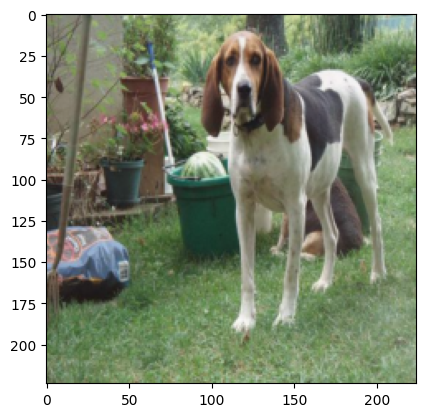

tensor([0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.9467, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0533, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000, 0.0000, 

In [ ]:
# function for mixup
def mixup_2_images(image_a, image_b, label_a, label_b, num_classes=120):
    ratio = torch.rand(1).item()  # 0~1 사이의 랜덤 값

    # 라벨 원핫 인코딩
    if isinstance(label_a, int):
        label_a = F.one_hot(torch.tensor(label_a), num_classes=num_classes).float()
    if isinstance(label_b, int):
        label_b = F.one_hot(torch.tensor(label_b), num_classes=num_classes).float()

    # 이미지와 라벨 혼합
    mixed_image = (1 - ratio) * image_a + ratio * image_b
    mixed_label = (1 - ratio) * label_a + ratio * label_b

    return mixed_image, mixed_label

# 예제 실행
mixed_img, mixed_label = mixup_2_images(image_a, image_b, label_a, label_b)

plt.imshow(mixed_img)
plt.show()

print(mixed_label)

In [ ]:
#  배치 단위의 mixup() 함수를 구현

def mixup(images, labels, batch_size=16, img_size=224, num_classes=120):
    mixed_imgs = []
    mixed_labels = []

    for i in range(batch_size):
        image_a = images[i]
        label_a = labels[i]

        # 랜덤하게 다른 이미지 선택
        j = torch.randint(0, batch_size, (1,)).item()
        image_b = images[j]
        label_b = labels[j]

        # Mixup 적용
        mixed_img, mixed_label = mixup_2_images(image_a, image_b, label_a, label_b, num_classes)

        mixed_imgs.append(mixed_img)
        mixed_labels.append(mixed_label)

    # 배치 차원 추가
    mixed_imgs = torch.stack(mixed_imgs).view(batch_size, 3, img_size, img_size)  # (B, C, H, W)
    mixed_labels = torch.stack(mixed_labels).view(batch_size, num_classes)  # (B, num_classes)

    return mixed_imgs, mixed_labels

# **프로젝트 : Mixup 또는 CutMix 비교실험**

# **실험 개요**

**비교 실험 대상**
*   No Augmentation
*   Augmentation 적용
*   Augmentation + MixUp
*   Augmentation + CutMix

**실험 조건**
*   Backbone: ResNet-50
*   Loss: categorical_crossentropy
*   Metric: Accuracy
*   Optimizer: Adam
*   Dataset: Fashion-MNIST (10 classes)

**가설 설정**
*   No Augmentation보다 데이터 증강 기법이 Validation accuracy 상승에 영향을 줄 것임
*   흑백 이미지이므로 Augmentation + MixUp의 성능이 가장 높을 것으로 예상됨


In [ ]:
# 라이브러리

import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, models
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# Fashion-MNIST 데이터셋 로드

(x_train, y_train), (x_test, y_test) = keras.datasets.fashion_mnist.load_data()

num_classes = 10

29515/29515 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
26421880/26421880 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step
5148/5148 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
4422102/4422102 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [ ]:
# 전처리

  # Fashion-MNIST는 흑백(1채널)이므로 ResNet-50 입력 규격(224×224×3)에 맞게 resize + channel 복제

def preprocess(images, labels):
    images = tf.expand_dims(images, -1)              # (H, W, 1)
    images = tf.image.resize(images, (224, 224))     # ResNet input
    images = tf.image.grayscale_to_rgb(images)       # (H, W, 3)
    images = tf.cast(images, tf.float32) / 255.0
    labels = tf.one_hot(labels, num_classes)
    return images, labels

In [ ]:
# One-Hot Encoding

train_ds = tf.data.Dataset.from_tensor_slices((x_train, y_train))
test_ds  = tf.data.Dataset.from_tensor_slices((x_test, y_test))

train_ds = train_ds.map(preprocess).shuffle(10000).batch(32)
test_ds  = test_ds.map(preprocess).batch(32)

In [ ]:
# Augmentation 정의

basic_augmentation = keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
])

def apply_basic_aug(images, labels):
    return basic_augmentation(images), labels

In [ ]:
# Mixup

def mixup(batch_x, batch_y, alpha=0.2):
    batch_size = tf.shape(batch_x)[0]
    lam = tf.random.uniform([batch_size, 1, 1, 1], 0, 1)

    index = tf.random.shuffle(tf.range(batch_size))
    mixed_x = lam * batch_x + (1 - lam) * tf.gather(batch_x, index)
    mixed_y = lam[:, 0, 0, 0][:, None] * batch_y + \
              (1 - lam[:, 0, 0, 0][:, None]) * tf.gather(batch_y, index)
    return mixed_x, mixed_y

In [ ]:
# cutMix

def cutmix(batch_x, batch_y, alpha=1.0):
    batch_size = tf.shape(batch_x)[0]
    lam = tf.random.uniform([], 0, 1)

    index = tf.random.shuffle(tf.range(batch_size))
    shuffled_x = tf.gather(batch_x, index)
    shuffled_y = tf.gather(batch_y, index)

    h, w = 224, 224
    cut_rat = tf.sqrt(1. - lam)
    cut_w = tf.cast(w * cut_rat, tf.int32)
    cut_h = tf.cast(h * cut_rat, tf.int32)

    cx = tf.random.uniform([], 0, w, dtype=tf.int32)
    cy = tf.random.uniform([], 0, h, dtype=tf.int32)

    x1 = tf.clip_by_value(cx - cut_w // 2, 0, w)
    x2 = tf.clip_by_value(cx + cut_w // 2, 0, w)
    y1 = tf.clip_by_value(cy - cut_h // 2, 0, h)
    y2 = tf.clip_by_value(cy + cut_h // 2, 0, h)

    mask = tf.ones((y2-y1, x2-x1, 3))
    padding = [[y1, h-y2], [x1, w-x2], [0, 0]]
    mask = tf.pad(mask, padding)

    mixed_x = batch_x * (1 - mask) + shuffled_x * mask
    lam_adj = 1 - tf.reduce_mean(mask)
    mixed_y = lam_adj * batch_y + (1 - lam_adj) * shuffled_y

    return mixed_x, mixed_y

In [ ]:
# ResNet-50 모델 생성(모델 2개 생성)

def build_resnet50():
    base = keras.applications.ResNet50(
        weights="imagenet",
        include_top=False,
        input_shape=(224, 224, 3)
    )
    base.trainable = False

    x = layers.GlobalAveragePooling2D()(base.output)
    x = layers.Dense(256, activation="relu")(x)
    output = layers.Dense(num_classes, activation="softmax")(x)

    model = models.Model(base.input, output)
    model.compile(
        optimizer="adam",
        loss="categorical_crossentropy",
        metrics=["accuracy"]
    )
    return model

In [ ]:
# 데이터셋 4가지 구성

# No Augmentation
ds_no_aug = train_ds

# Basic Augmentation
ds_basic_aug = train_ds.map(apply_basic_aug)

# Basic + Mixup
ds_mixup = train_ds.map(apply_basic_aug).map(mixup)

# Basic + CutMix
ds_cutmix = train_ds.map(apply_basic_aug).map(cutmix)

In [ ]:
# 모델 훈련

histories = {}
datasets = {
    "No Aug": ds_no_aug,
    "Basic Aug": ds_basic_aug,
    "Basic + Mixup": ds_mixup,
    "Basic + CutMix": ds_cutmix
}

for name, ds in datasets.items():
    print(f"\nTraining: {name}")
    model = build_resnet50()
    history = model.fit(
        ds,
        validation_data=test_ds,
        epochs=10
    )
    histories[name] = history


Training: No Aug
94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step
Epoch 1/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 68s 27ms/step - accuracy: 0.4884 - loss: 1.4473 - val_accuracy: 0.6610 - val_loss: 0.8928
Epoch 2/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 42s 22ms/step - accuracy: 0.6990 - loss: 0.8263 - val_accuracy: 0.7337 - val_loss: 0.7492
Epoch 3/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 42s 22ms/step - accuracy: 0.7351 - loss: 0.7273 - val_accuracy: 0.7602 - val_loss: 0.6482
Epoch 4/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 42s 22ms/step - accuracy: 0.7551 - loss: 0.6657 - val_accuracy: 0.7666 - val_loss: 0.6319
Epoch 5/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 42s 22ms/step - accuracy: 0.7672 - loss: 0.6360 - val_accuracy: 0.7583 - val_loss: 0.6633
Epoch 6/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 42s 22ms/step - accuracy: 0.7755 - loss: 0.6077 - val_accuracy: 0.7867 - val_loss: 0.5851
Epoch 7/10
1875/1875 ━━━━━━━━━━━━━━━━━━━━ 42s 22ms/step - accuracy: 0.7814 - loss: 0.5939 - val_accuracy: 0.7852 - val_loss: 0.5764
Epoch 8

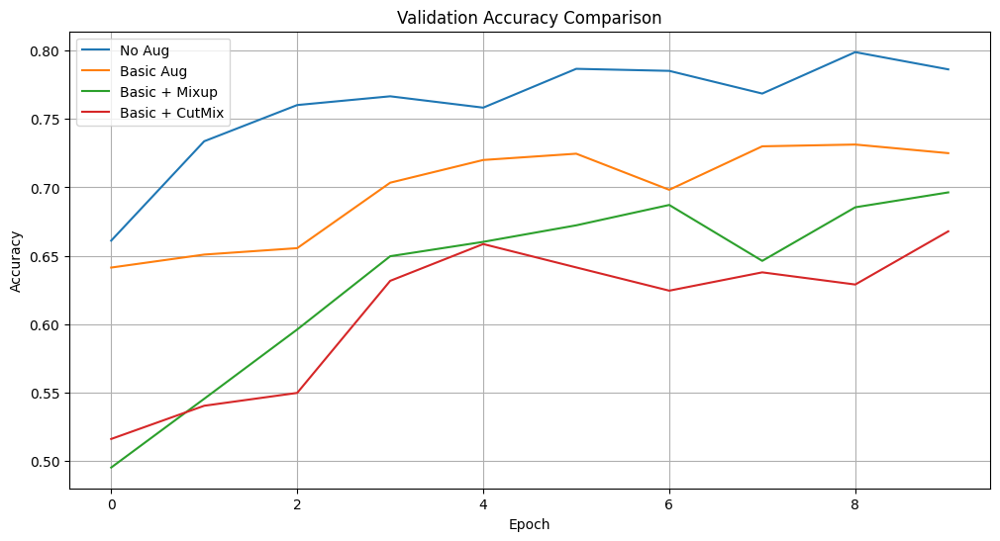

In [ ]:
# 훈련과정 시각화

plt.figure(figsize=(12,6))
for name, h in histories.items():
    plt.plot(h.history["val_accuracy"], label=name)

plt.title("Validation Accuracy Comparison")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend()
plt.grid()
plt.show()

# **결과 분석 보고서**

**결과 분석**

*   No Augmentation
    *   학습 정확도는 빠르게 상승하였으나, 검증 정확도가 에폭 4이후 정체 및 하락의 추이를 보였다는 점에서 학습과 검증 성능 간 격차 발생
    *   모델이 학습 데이터에 과적합되는 현상의 패턴으로 판단됨
*   Augmentation
    *   학습 정확도의 상승 속도는 다소 완만하나 검증 정확도 곡선은 안정적
    *   단순한 데이터 증강(Flip이나 Crop 등)만으로 과적합 완화 효과를 보여줌
*   Augmentation + MixUp
    *   학습 정확도의 상승 속도는 가장 느리지만, 검증 정확도는 비교적 안정적
    *   Decision boundary를 부드럽게 만드는 MixUp의 효과로 규제 효과가 발생한 것으로 사료됨
*   Augmentation + CutMix
    *   학습 정확도는 Mixup 대비 빠르게 상승하였지만, 특정 에폭 이후 변동성이 증가하는 경향을 보임
*   종합 결과 분석
    *   가설과 달리 No Augmentation에서 유효 정확도가 높게 나온 것은 Fashion-MNIST 데이터셋의 낮은 학습 난이도(흑백 이미지), 사전학습된 ResNet-50의 강한 표현력, 제한된 학습 에폭 수가 원인으로 분석할 수 있음
    *   No Augmentation이 데이터 증강보다 우수한 성능을 도출한다고 해석할 수 없음
    *   데이터셋의 특징이 데이터 증강에 의한 효과를 발현하여 모델의 성능을 향상시킨다는 것을 알 수 있음
    *   Validation accuracy의 추이를 관찰하였을 때 에폭 수가 제한되어 충분히 발현되지 않았지만, MixUp과 CutMix는 장기 학습에서 과적합을 완화하는 기법으로 적합한 것으로 판단됨

**실험의 한계점**

*   에폭 수 제한으로 인해 완전한 수렴 및 과적합 구간 관찰에 한계
*   단일 모델 구조 기반 실험으로 모델–증강 기법 간 상호작용 분석 부족

**향후 실험 보완 방향**

*   에폭 수 증가 및 학습 수렴 분석 추가
*   해상도와 객체 크기 변화에 따른 CutMix 및 MixUp 효과 분석



# **회고**


*   Data Augmentation을 적용하기 전과 후를 비교했을때 적용 후에 일반화 성능 개선하여 모델 성능을 안정적으로 나타나는 경우가 있었음을 알게 되었다.
*   컴퓨팅 자원이 여유된다면 에폭수를 더 높여 성능 수렴과 과적합을 관찰할 수 있겠으나 본 실험은 재현성을 통하여 성능 비교가 목적이므로 Early Stopping 하였다.
*   CutMix와 Mixup의 경우 데이터셋의 특징(원본 해상도 등)에 따라 성능이 유동적이며 절대적이지 않음을 알 수 있었다.

